# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #2
  (fname, cnt))
/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #3
  (fname, cnt))
/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
!mkdir data

mkdir: cannot create directory 'data': File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:19, 9.29MB/s]                              
SVHN Testing Set: 64.3MB [00:08, 7.65MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

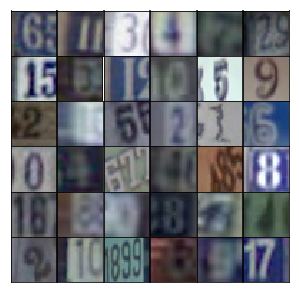

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [33]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4 * 4 * 512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1) # LRLU
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2) #LRLU
        # 8x8x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3) #LRLU
        # 16x16x128
            
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [34]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer,
        # then double the depth as you add layers. Note that in the DCGAN paper,
        # they did all the downsampling using only strided convolutional layers with no maxpool layers.
        
        # You'll also want to use batch normalization with tf.layers.batch_normalization on each layer
        # except the first convolutional and output layers.
        # Again, each layer should look something like convolution > batch norm > leaky ReLU
        
        
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x, x) #LRLU
        #16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2)
        relu2 = tf.maximum(alpha * bn2, bn2) #LRLU
        #8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3)
        relu3 = tf.maximum(alpha * bn3, bn3) #LRLU
        #4x4x256 
        
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [35]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [36]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [37]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [38]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [39]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [40]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.7443... Generator Loss: 1.3115
Epoch 1/25... Discriminator Loss: 0.2655... Generator Loss: 1.9566
Epoch 1/25... Discriminator Loss: 2.5042... Generator Loss: 1.1417
Epoch 1/25... Discriminator Loss: 0.9727... Generator Loss: 1.0894
Epoch 1/25... Discriminator Loss: 0.8335... Generator Loss: 1.2285
Epoch 1/25... Discriminator Loss: 0.8194... Generator Loss: 1.2026
Epoch 1/25... Discriminator Loss: 0.8830... Generator Loss: 1.0873
Epoch 1/25... Discriminator Loss: 1.0537... Generator Loss: 0.9727
Epoch 1/25... Discriminator Loss: 1.0718... Generator Loss: 1.0101
Epoch 1/25... Discriminator Loss: 0.9890... Generator Loss: 1.2287


/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


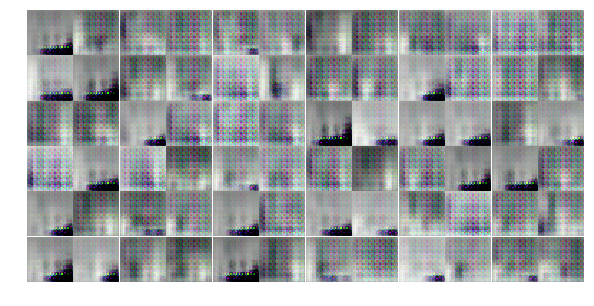

Epoch 1/25... Discriminator Loss: 1.2151... Generator Loss: 1.0016
Epoch 1/25... Discriminator Loss: 1.2607... Generator Loss: 0.9548
Epoch 1/25... Discriminator Loss: 1.1632... Generator Loss: 0.7289
Epoch 1/25... Discriminator Loss: 1.2352... Generator Loss: 0.9709
Epoch 1/25... Discriminator Loss: 1.2818... Generator Loss: 0.8703
Epoch 1/25... Discriminator Loss: 1.2901... Generator Loss: 0.7189
Epoch 1/25... Discriminator Loss: 1.2328... Generator Loss: 0.8654
Epoch 1/25... Discriminator Loss: 1.2602... Generator Loss: 0.8813
Epoch 1/25... Discriminator Loss: 1.2895... Generator Loss: 0.9159
Epoch 1/25... Discriminator Loss: 1.4248... Generator Loss: 0.6894


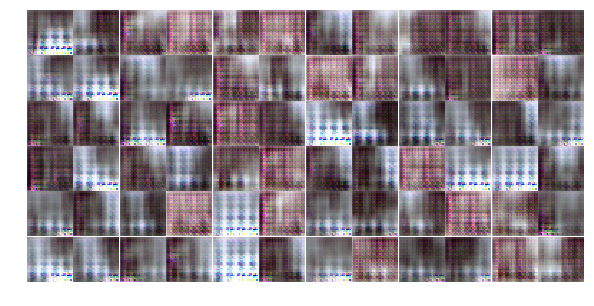

Epoch 1/25... Discriminator Loss: 1.6976... Generator Loss: 0.6448
Epoch 1/25... Discriminator Loss: 1.2099... Generator Loss: 0.9166
Epoch 1/25... Discriminator Loss: 1.1957... Generator Loss: 0.8256
Epoch 1/25... Discriminator Loss: 1.1968... Generator Loss: 0.7207
Epoch 1/25... Discriminator Loss: 1.4870... Generator Loss: 1.0314
Epoch 1/25... Discriminator Loss: 1.2399... Generator Loss: 0.7930
Epoch 1/25... Discriminator Loss: 1.3488... Generator Loss: 0.7175
Epoch 1/25... Discriminator Loss: 1.1913... Generator Loss: 0.9079
Epoch 1/25... Discriminator Loss: 1.2068... Generator Loss: 0.7237
Epoch 1/25... Discriminator Loss: 1.4282... Generator Loss: 1.0945


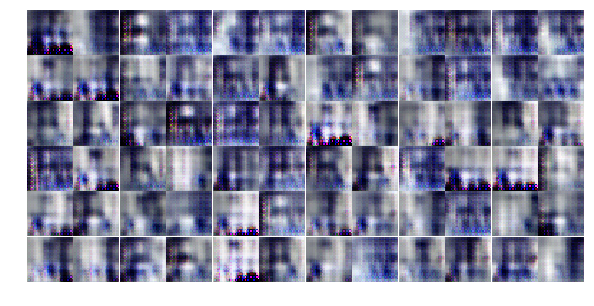

Epoch 1/25... Discriminator Loss: 1.2536... Generator Loss: 0.8081
Epoch 1/25... Discriminator Loss: 1.1072... Generator Loss: 0.9874
Epoch 1/25... Discriminator Loss: 1.2736... Generator Loss: 0.8554
Epoch 1/25... Discriminator Loss: 1.2985... Generator Loss: 0.8558
Epoch 1/25... Discriminator Loss: 1.3366... Generator Loss: 0.7200
Epoch 1/25... Discriminator Loss: 1.2815... Generator Loss: 0.8387
Epoch 1/25... Discriminator Loss: 1.1638... Generator Loss: 0.9235
Epoch 1/25... Discriminator Loss: 1.2584... Generator Loss: 0.9303
Epoch 1/25... Discriminator Loss: 1.1502... Generator Loss: 0.9086
Epoch 1/25... Discriminator Loss: 1.1675... Generator Loss: 0.7873


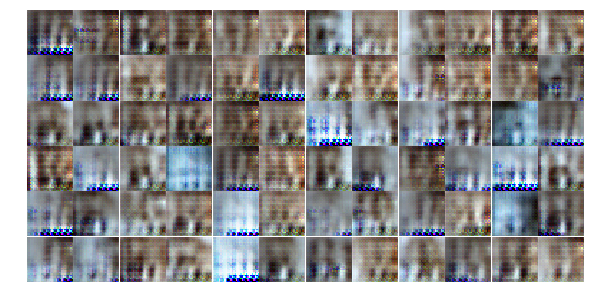

Epoch 1/25... Discriminator Loss: 1.3002... Generator Loss: 0.8098
Epoch 1/25... Discriminator Loss: 1.2583... Generator Loss: 0.7118
Epoch 1/25... Discriminator Loss: 1.2111... Generator Loss: 0.7327
Epoch 1/25... Discriminator Loss: 1.2041... Generator Loss: 0.9055
Epoch 1/25... Discriminator Loss: 1.2518... Generator Loss: 0.7226
Epoch 1/25... Discriminator Loss: 1.3904... Generator Loss: 0.7021
Epoch 1/25... Discriminator Loss: 1.3846... Generator Loss: 0.6852
Epoch 1/25... Discriminator Loss: 1.3312... Generator Loss: 0.7204
Epoch 1/25... Discriminator Loss: 1.1877... Generator Loss: 0.8962
Epoch 1/25... Discriminator Loss: 1.2803... Generator Loss: 0.7888


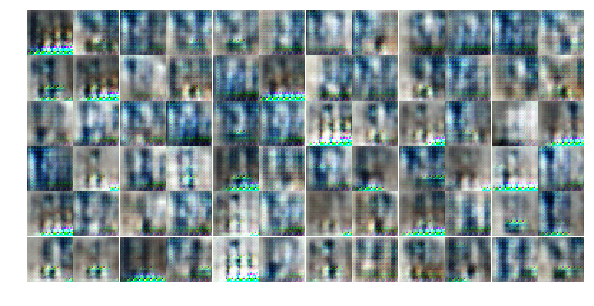

Epoch 1/25... Discriminator Loss: 1.2989... Generator Loss: 0.8662
Epoch 1/25... Discriminator Loss: 1.1847... Generator Loss: 0.8247
Epoch 1/25... Discriminator Loss: 1.6161... Generator Loss: 0.6319
Epoch 1/25... Discriminator Loss: 1.3286... Generator Loss: 0.8600
Epoch 1/25... Discriminator Loss: 1.2417... Generator Loss: 0.7796
Epoch 1/25... Discriminator Loss: 1.2374... Generator Loss: 0.8206
Epoch 1/25... Discriminator Loss: 1.3116... Generator Loss: 0.8259
Epoch 2/25... Discriminator Loss: 1.3332... Generator Loss: 0.7927
Epoch 2/25... Discriminator Loss: 1.3086... Generator Loss: 0.7290
Epoch 2/25... Discriminator Loss: 1.1691... Generator Loss: 0.8758


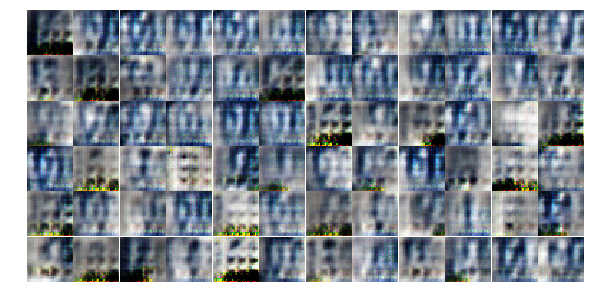

Epoch 2/25... Discriminator Loss: 1.1948... Generator Loss: 0.9304
Epoch 2/25... Discriminator Loss: 1.3381... Generator Loss: 0.7671
Epoch 2/25... Discriminator Loss: 1.3532... Generator Loss: 0.7715
Epoch 2/25... Discriminator Loss: 1.2320... Generator Loss: 0.7794
Epoch 2/25... Discriminator Loss: 1.3196... Generator Loss: 0.7660
Epoch 2/25... Discriminator Loss: 1.3454... Generator Loss: 1.0264
Epoch 2/25... Discriminator Loss: 1.3788... Generator Loss: 1.0581
Epoch 2/25... Discriminator Loss: 1.2066... Generator Loss: 1.1097
Epoch 2/25... Discriminator Loss: 1.4595... Generator Loss: 0.9794
Epoch 2/25... Discriminator Loss: 1.2571... Generator Loss: 0.8673


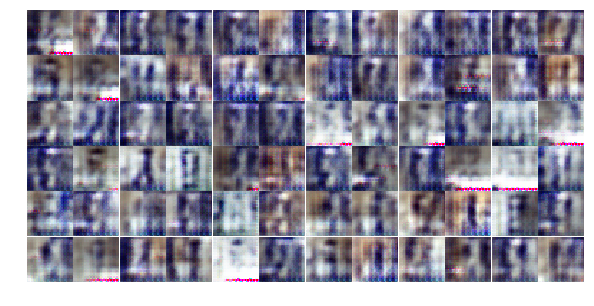

Epoch 2/25... Discriminator Loss: 1.2829... Generator Loss: 0.7770
Epoch 2/25... Discriminator Loss: 1.3185... Generator Loss: 0.8961
Epoch 2/25... Discriminator Loss: 1.3729... Generator Loss: 0.6174
Epoch 2/25... Discriminator Loss: 1.2959... Generator Loss: 0.7573
Epoch 2/25... Discriminator Loss: 1.1995... Generator Loss: 0.7379
Epoch 2/25... Discriminator Loss: 1.2290... Generator Loss: 0.9548
Epoch 2/25... Discriminator Loss: 1.2970... Generator Loss: 0.7291
Epoch 2/25... Discriminator Loss: 1.2006... Generator Loss: 0.7931
Epoch 2/25... Discriminator Loss: 1.3274... Generator Loss: 0.8251
Epoch 2/25... Discriminator Loss: 1.2920... Generator Loss: 0.8038


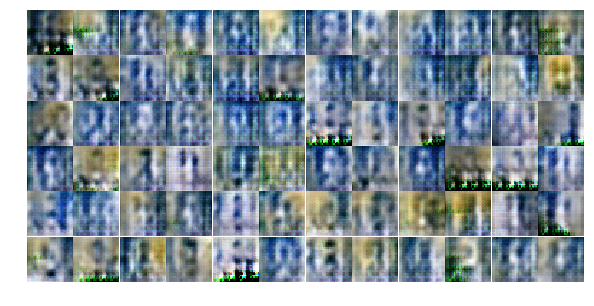

Epoch 2/25... Discriminator Loss: 1.4044... Generator Loss: 0.8287
Epoch 2/25... Discriminator Loss: 1.1677... Generator Loss: 0.8659
Epoch 2/25... Discriminator Loss: 1.2513... Generator Loss: 0.8169
Epoch 2/25... Discriminator Loss: 1.2823... Generator Loss: 0.7335
Epoch 2/25... Discriminator Loss: 1.4654... Generator Loss: 1.2723
Epoch 2/25... Discriminator Loss: 1.2301... Generator Loss: 0.8812
Epoch 2/25... Discriminator Loss: 1.3442... Generator Loss: 0.8275
Epoch 2/25... Discriminator Loss: 1.2841... Generator Loss: 0.7035
Epoch 2/25... Discriminator Loss: 1.4102... Generator Loss: 0.8938
Epoch 2/25... Discriminator Loss: 1.2829... Generator Loss: 0.7451


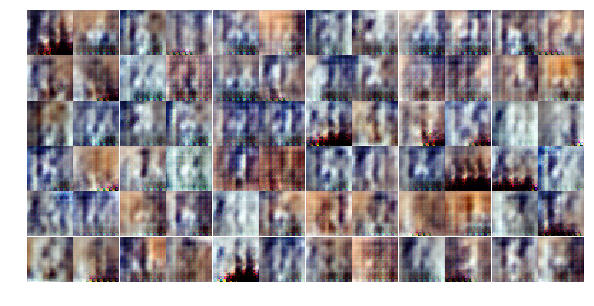

Epoch 2/25... Discriminator Loss: 1.2873... Generator Loss: 0.7751
Epoch 2/25... Discriminator Loss: 1.3361... Generator Loss: 0.7971
Epoch 2/25... Discriminator Loss: 1.3781... Generator Loss: 0.6976
Epoch 2/25... Discriminator Loss: 1.2700... Generator Loss: 0.8734
Epoch 2/25... Discriminator Loss: 1.2627... Generator Loss: 0.8230
Epoch 2/25... Discriminator Loss: 1.3270... Generator Loss: 0.7139
Epoch 2/25... Discriminator Loss: 1.2329... Generator Loss: 0.7273
Epoch 2/25... Discriminator Loss: 1.3302... Generator Loss: 0.7652
Epoch 2/25... Discriminator Loss: 1.3296... Generator Loss: 0.7446
Epoch 2/25... Discriminator Loss: 1.2590... Generator Loss: 0.7127


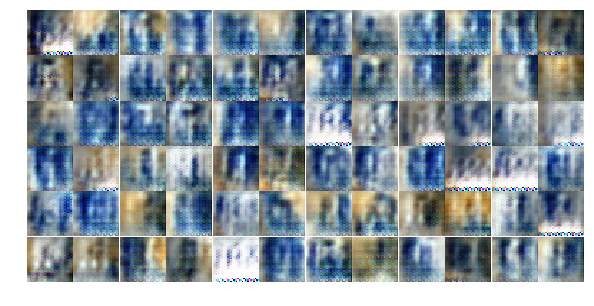

Epoch 2/25... Discriminator Loss: 1.3863... Generator Loss: 0.9304
Epoch 2/25... Discriminator Loss: 1.3124... Generator Loss: 0.7540
Epoch 2/25... Discriminator Loss: 1.3720... Generator Loss: 0.6625
Epoch 2/25... Discriminator Loss: 1.3261... Generator Loss: 0.7929
Epoch 2/25... Discriminator Loss: 1.4478... Generator Loss: 0.6633
Epoch 2/25... Discriminator Loss: 1.3949... Generator Loss: 0.7091
Epoch 2/25... Discriminator Loss: 1.2569... Generator Loss: 0.7693
Epoch 2/25... Discriminator Loss: 1.3340... Generator Loss: 0.7794
Epoch 2/25... Discriminator Loss: 1.3180... Generator Loss: 0.6292
Epoch 2/25... Discriminator Loss: 1.2732... Generator Loss: 0.6905


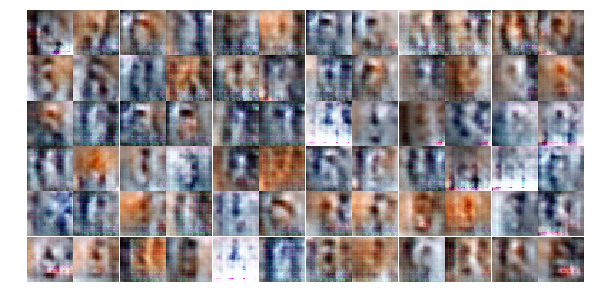

Epoch 2/25... Discriminator Loss: 1.3422... Generator Loss: 0.9035
Epoch 2/25... Discriminator Loss: 1.1873... Generator Loss: 0.7393
Epoch 2/25... Discriminator Loss: 1.2937... Generator Loss: 0.7399
Epoch 2/25... Discriminator Loss: 1.2962... Generator Loss: 0.7602
Epoch 3/25... Discriminator Loss: 1.3130... Generator Loss: 0.8399
Epoch 3/25... Discriminator Loss: 1.3759... Generator Loss: 0.6523
Epoch 3/25... Discriminator Loss: 1.2624... Generator Loss: 0.7846
Epoch 3/25... Discriminator Loss: 1.2633... Generator Loss: 0.7799
Epoch 3/25... Discriminator Loss: 1.2518... Generator Loss: 0.7763
Epoch 3/25... Discriminator Loss: 1.2759... Generator Loss: 0.7982


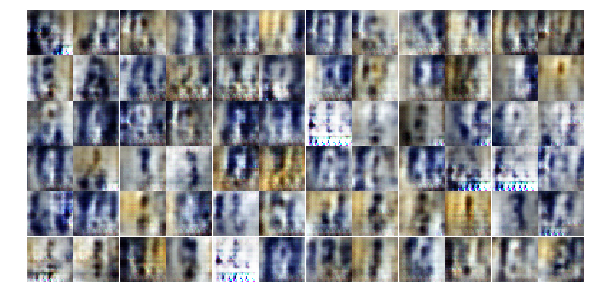

Epoch 3/25... Discriminator Loss: 1.3149... Generator Loss: 0.8814
Epoch 3/25... Discriminator Loss: 1.2925... Generator Loss: 0.7985
Epoch 3/25... Discriminator Loss: 1.2987... Generator Loss: 0.8884
Epoch 3/25... Discriminator Loss: 1.2500... Generator Loss: 0.8321
Epoch 3/25... Discriminator Loss: 1.3009... Generator Loss: 0.7542
Epoch 3/25... Discriminator Loss: 1.2738... Generator Loss: 0.7511
Epoch 3/25... Discriminator Loss: 1.2453... Generator Loss: 0.8047
Epoch 3/25... Discriminator Loss: 1.3215... Generator Loss: 0.8440
Epoch 3/25... Discriminator Loss: 1.3432... Generator Loss: 0.9061
Epoch 3/25... Discriminator Loss: 1.2750... Generator Loss: 0.7248


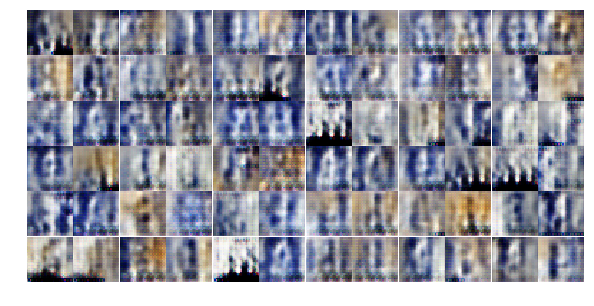

Epoch 3/25... Discriminator Loss: 1.2644... Generator Loss: 0.6990
Epoch 3/25... Discriminator Loss: 1.2642... Generator Loss: 0.8861
Epoch 3/25... Discriminator Loss: 1.4570... Generator Loss: 0.9890
Epoch 3/25... Discriminator Loss: 1.3170... Generator Loss: 0.7297
Epoch 3/25... Discriminator Loss: 1.2851... Generator Loss: 0.7735
Epoch 3/25... Discriminator Loss: 1.2195... Generator Loss: 0.9529
Epoch 3/25... Discriminator Loss: 1.3014... Generator Loss: 0.8519
Epoch 3/25... Discriminator Loss: 1.3300... Generator Loss: 0.8365
Epoch 3/25... Discriminator Loss: 1.3020... Generator Loss: 0.7824
Epoch 3/25... Discriminator Loss: 1.4131... Generator Loss: 0.5892


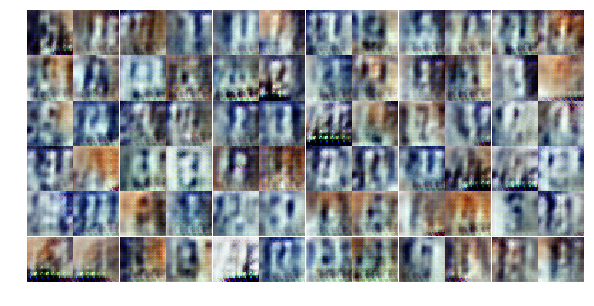

Epoch 3/25... Discriminator Loss: 1.3159... Generator Loss: 0.8340
Epoch 3/25... Discriminator Loss: 1.2096... Generator Loss: 0.8388
Epoch 3/25... Discriminator Loss: 1.3327... Generator Loss: 0.7581
Epoch 3/25... Discriminator Loss: 1.1396... Generator Loss: 0.8127
Epoch 3/25... Discriminator Loss: 1.2762... Generator Loss: 0.8236
Epoch 3/25... Discriminator Loss: 1.3242... Generator Loss: 0.9957
Epoch 3/25... Discriminator Loss: 1.5377... Generator Loss: 0.7230
Epoch 3/25... Discriminator Loss: 1.3714... Generator Loss: 0.6582
Epoch 3/25... Discriminator Loss: 1.3277... Generator Loss: 0.6588
Epoch 3/25... Discriminator Loss: 1.3844... Generator Loss: 0.7461


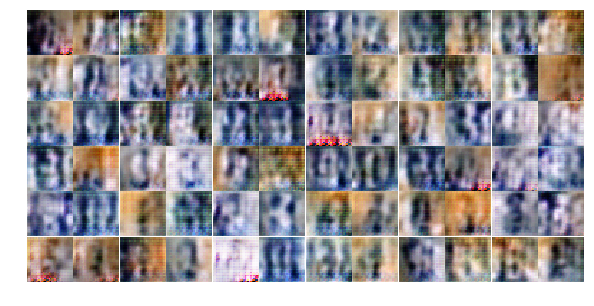

Epoch 3/25... Discriminator Loss: 1.3432... Generator Loss: 0.9774
Epoch 3/25... Discriminator Loss: 1.4368... Generator Loss: 0.8118
Epoch 3/25... Discriminator Loss: 1.3369... Generator Loss: 0.7926
Epoch 3/25... Discriminator Loss: 1.2412... Generator Loss: 0.7796
Epoch 3/25... Discriminator Loss: 1.3397... Generator Loss: 0.7136
Epoch 3/25... Discriminator Loss: 1.3517... Generator Loss: 0.6369
Epoch 3/25... Discriminator Loss: 1.3140... Generator Loss: 0.8034
Epoch 3/25... Discriminator Loss: 1.3161... Generator Loss: 0.7178
Epoch 3/25... Discriminator Loss: 1.2462... Generator Loss: 0.7047
Epoch 3/25... Discriminator Loss: 1.3045... Generator Loss: 0.7589


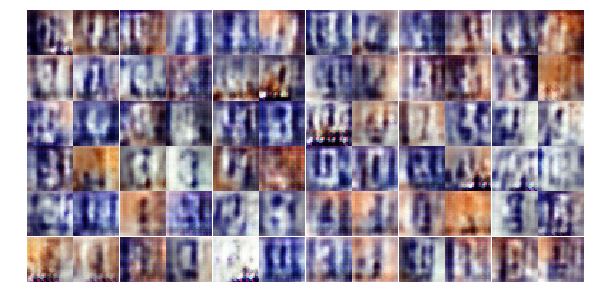

Epoch 3/25... Discriminator Loss: 1.3065... Generator Loss: 0.7390
Epoch 3/25... Discriminator Loss: 1.3853... Generator Loss: 0.7828
Epoch 3/25... Discriminator Loss: 1.3502... Generator Loss: 0.7034
Epoch 3/25... Discriminator Loss: 1.2293... Generator Loss: 0.8142
Epoch 3/25... Discriminator Loss: 1.2943... Generator Loss: 0.6622
Epoch 3/25... Discriminator Loss: 1.3354... Generator Loss: 0.8448
Epoch 3/25... Discriminator Loss: 1.2651... Generator Loss: 0.7066
Epoch 3/25... Discriminator Loss: 1.3288... Generator Loss: 0.7121
Epoch 3/25... Discriminator Loss: 1.2824... Generator Loss: 0.8803
Epoch 3/25... Discriminator Loss: 1.3879... Generator Loss: 0.8029


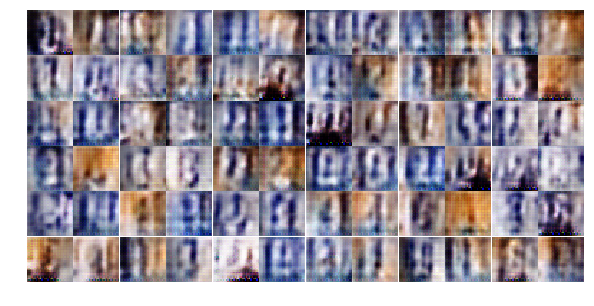

Epoch 3/25... Discriminator Loss: 1.2928... Generator Loss: 0.7289
Epoch 4/25... Discriminator Loss: 1.2801... Generator Loss: 0.8948
Epoch 4/25... Discriminator Loss: 1.3570... Generator Loss: 0.7001
Epoch 4/25... Discriminator Loss: 1.3231... Generator Loss: 0.6809
Epoch 4/25... Discriminator Loss: 1.3453... Generator Loss: 0.7625
Epoch 4/25... Discriminator Loss: 1.3504... Generator Loss: 0.6559
Epoch 4/25... Discriminator Loss: 1.2712... Generator Loss: 0.8656
Epoch 4/25... Discriminator Loss: 1.3774... Generator Loss: 0.7832
Epoch 4/25... Discriminator Loss: 1.3627... Generator Loss: 0.8574
Epoch 4/25... Discriminator Loss: 1.3063... Generator Loss: 0.7605


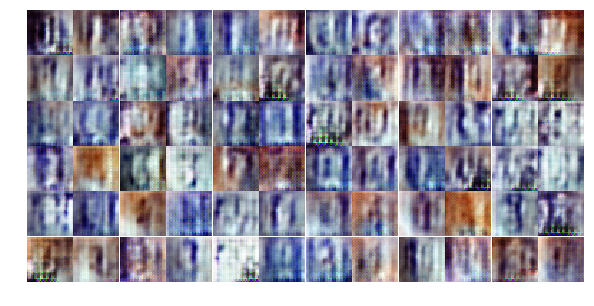

Epoch 4/25... Discriminator Loss: 1.5042... Generator Loss: 0.7709
Epoch 4/25... Discriminator Loss: 1.2449... Generator Loss: 0.7737
Epoch 4/25... Discriminator Loss: 1.3844... Generator Loss: 0.7754
Epoch 4/25... Discriminator Loss: 1.3199... Generator Loss: 0.6129
Epoch 4/25... Discriminator Loss: 1.4062... Generator Loss: 0.6609
Epoch 4/25... Discriminator Loss: 1.4243... Generator Loss: 0.6791
Epoch 4/25... Discriminator Loss: 1.3284... Generator Loss: 0.7936
Epoch 4/25... Discriminator Loss: 1.2933... Generator Loss: 0.7619
Epoch 4/25... Discriminator Loss: 1.3246... Generator Loss: 0.8831
Epoch 4/25... Discriminator Loss: 1.3393... Generator Loss: 0.8550


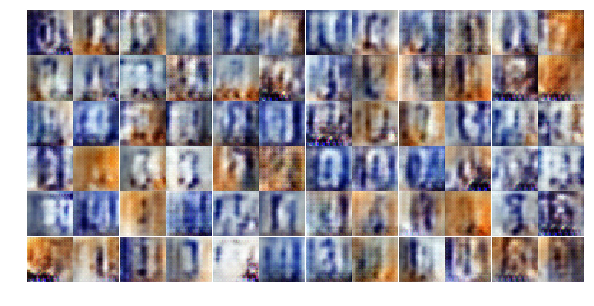

Epoch 4/25... Discriminator Loss: 1.3525... Generator Loss: 0.8437
Epoch 4/25... Discriminator Loss: 1.3042... Generator Loss: 0.8014
Epoch 4/25... Discriminator Loss: 1.3124... Generator Loss: 0.7555
Epoch 4/25... Discriminator Loss: 1.3586... Generator Loss: 0.9513
Epoch 4/25... Discriminator Loss: 1.3868... Generator Loss: 0.8165
Epoch 4/25... Discriminator Loss: 1.3353... Generator Loss: 0.6626
Epoch 4/25... Discriminator Loss: 1.4519... Generator Loss: 0.7667
Epoch 4/25... Discriminator Loss: 1.3594... Generator Loss: 0.7082
Epoch 4/25... Discriminator Loss: 1.3260... Generator Loss: 0.7602
Epoch 4/25... Discriminator Loss: 1.3502... Generator Loss: 0.8697


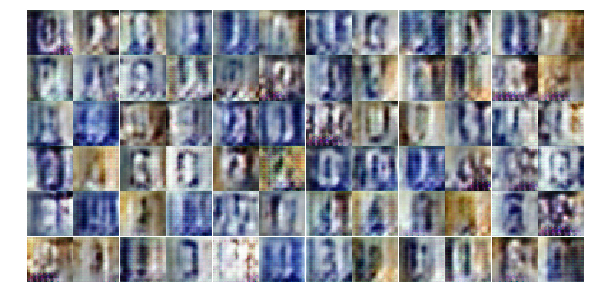

Epoch 4/25... Discriminator Loss: 1.3311... Generator Loss: 0.7374
Epoch 4/25... Discriminator Loss: 1.3013... Generator Loss: 0.8153
Epoch 4/25... Discriminator Loss: 1.2967... Generator Loss: 0.7842
Epoch 4/25... Discriminator Loss: 1.3605... Generator Loss: 0.7744
Epoch 4/25... Discriminator Loss: 1.2603... Generator Loss: 0.7076
Epoch 4/25... Discriminator Loss: 1.3498... Generator Loss: 0.7417
Epoch 4/25... Discriminator Loss: 1.3417... Generator Loss: 0.7625
Epoch 4/25... Discriminator Loss: 1.3145... Generator Loss: 0.6635
Epoch 4/25... Discriminator Loss: 1.2878... Generator Loss: 0.7769
Epoch 4/25... Discriminator Loss: 1.3519... Generator Loss: 0.8133


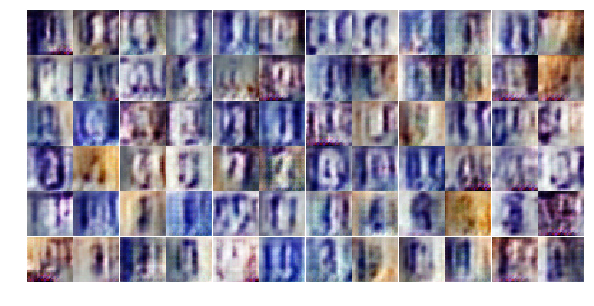

Epoch 4/25... Discriminator Loss: 1.3265... Generator Loss: 0.8331
Epoch 4/25... Discriminator Loss: 1.3497... Generator Loss: 0.7449
Epoch 4/25... Discriminator Loss: 1.3436... Generator Loss: 0.6764
Epoch 4/25... Discriminator Loss: 1.2850... Generator Loss: 0.7713
Epoch 4/25... Discriminator Loss: 1.3467... Generator Loss: 0.7913
Epoch 4/25... Discriminator Loss: 1.3381... Generator Loss: 0.7730
Epoch 4/25... Discriminator Loss: 1.4209... Generator Loss: 0.6039
Epoch 4/25... Discriminator Loss: 1.3706... Generator Loss: 0.6648
Epoch 4/25... Discriminator Loss: 1.3334... Generator Loss: 0.8471
Epoch 4/25... Discriminator Loss: 1.3265... Generator Loss: 0.6517


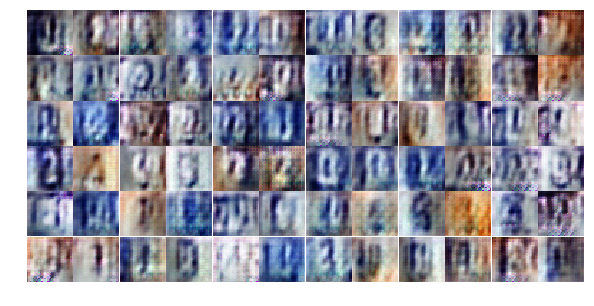

Epoch 4/25... Discriminator Loss: 1.2999... Generator Loss: 0.7191
Epoch 4/25... Discriminator Loss: 1.3731... Generator Loss: 0.8246
Epoch 4/25... Discriminator Loss: 1.2917... Generator Loss: 0.7120
Epoch 4/25... Discriminator Loss: 1.3038... Generator Loss: 0.7487
Epoch 4/25... Discriminator Loss: 1.3707... Generator Loss: 0.8757
Epoch 4/25... Discriminator Loss: 1.4031... Generator Loss: 0.6936
Epoch 4/25... Discriminator Loss: 1.3399... Generator Loss: 0.7993
Epoch 4/25... Discriminator Loss: 1.3470... Generator Loss: 0.7352
Epoch 4/25... Discriminator Loss: 1.3444... Generator Loss: 0.8141
Epoch 5/25... Discriminator Loss: 1.3606... Generator Loss: 0.7259


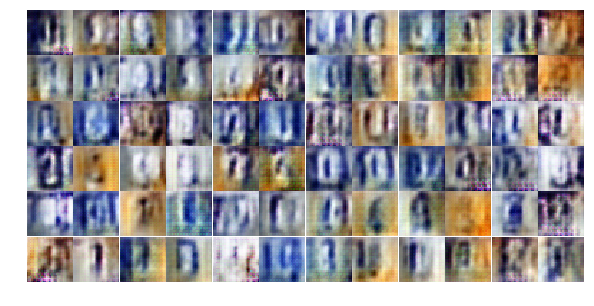

Epoch 5/25... Discriminator Loss: 1.2968... Generator Loss: 0.8017
Epoch 5/25... Discriminator Loss: 1.3620... Generator Loss: 0.7792
Epoch 5/25... Discriminator Loss: 1.3301... Generator Loss: 0.7260
Epoch 5/25... Discriminator Loss: 1.3379... Generator Loss: 0.8360
Epoch 5/25... Discriminator Loss: 1.3093... Generator Loss: 0.7251
Epoch 5/25... Discriminator Loss: 1.3665... Generator Loss: 0.7328
Epoch 5/25... Discriminator Loss: 1.3483... Generator Loss: 0.8213
Epoch 5/25... Discriminator Loss: 1.3059... Generator Loss: 0.7391
Epoch 5/25... Discriminator Loss: 1.3387... Generator Loss: 0.7946
Epoch 5/25... Discriminator Loss: 1.3870... Generator Loss: 0.8790


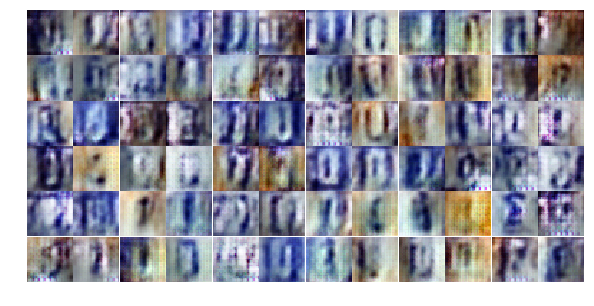

Epoch 5/25... Discriminator Loss: 1.4065... Generator Loss: 0.5867
Epoch 5/25... Discriminator Loss: 1.3585... Generator Loss: 0.7051
Epoch 5/25... Discriminator Loss: 1.3372... Generator Loss: 0.8585
Epoch 5/25... Discriminator Loss: 1.3599... Generator Loss: 0.7727
Epoch 5/25... Discriminator Loss: 1.3561... Generator Loss: 0.7390
Epoch 5/25... Discriminator Loss: 1.3494... Generator Loss: 0.7031
Epoch 5/25... Discriminator Loss: 1.4279... Generator Loss: 0.6926
Epoch 5/25... Discriminator Loss: 1.3814... Generator Loss: 0.7420
Epoch 5/25... Discriminator Loss: 1.3507... Generator Loss: 0.7296
Epoch 5/25... Discriminator Loss: 1.3150... Generator Loss: 0.7963


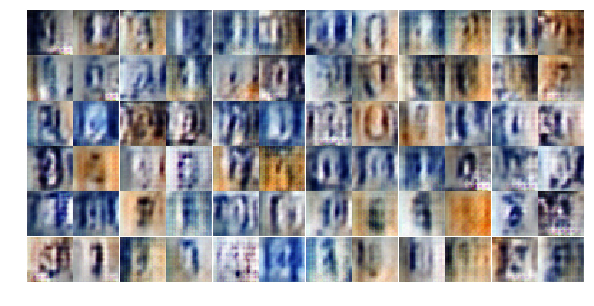

Epoch 5/25... Discriminator Loss: 1.4641... Generator Loss: 0.7573
Epoch 5/25... Discriminator Loss: 1.4446... Generator Loss: 0.8104
Epoch 5/25... Discriminator Loss: 1.4142... Generator Loss: 0.7913
Epoch 5/25... Discriminator Loss: 1.3518... Generator Loss: 0.6522
Epoch 5/25... Discriminator Loss: 1.3923... Generator Loss: 0.8772
Epoch 5/25... Discriminator Loss: 1.3428... Generator Loss: 0.6503
Epoch 5/25... Discriminator Loss: 1.3367... Generator Loss: 0.7378
Epoch 5/25... Discriminator Loss: 1.4248... Generator Loss: 0.6575
Epoch 5/25... Discriminator Loss: 1.3509... Generator Loss: 0.6299
Epoch 5/25... Discriminator Loss: 1.3900... Generator Loss: 0.7441


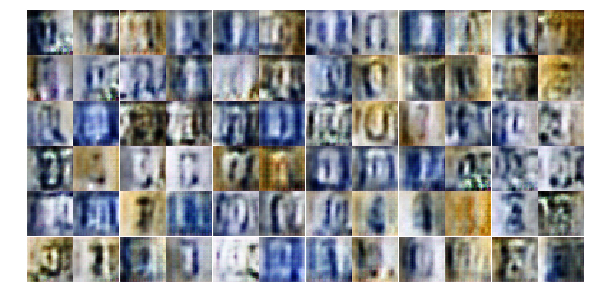

Epoch 5/25... Discriminator Loss: 1.3728... Generator Loss: 0.7157
Epoch 5/25... Discriminator Loss: 1.3349... Generator Loss: 0.7136
Epoch 5/25... Discriminator Loss: 1.3811... Generator Loss: 0.7082
Epoch 5/25... Discriminator Loss: 1.3343... Generator Loss: 0.6094
Epoch 5/25... Discriminator Loss: 1.3661... Generator Loss: 0.6787
Epoch 5/25... Discriminator Loss: 1.2933... Generator Loss: 0.7239
Epoch 5/25... Discriminator Loss: 1.3748... Generator Loss: 0.8114
Epoch 5/25... Discriminator Loss: 1.3397... Generator Loss: 0.7108
Epoch 5/25... Discriminator Loss: 1.3603... Generator Loss: 0.7355
Epoch 5/25... Discriminator Loss: 1.3133... Generator Loss: 0.7299


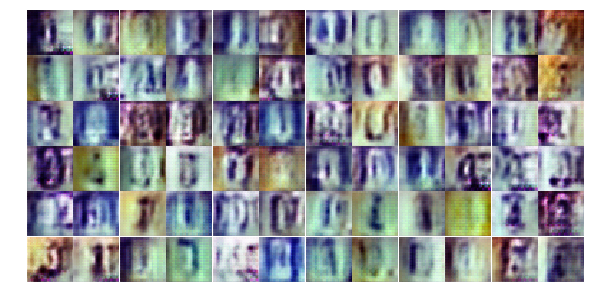

Epoch 5/25... Discriminator Loss: 1.3707... Generator Loss: 0.7209
Epoch 5/25... Discriminator Loss: 1.3375... Generator Loss: 0.7889
Epoch 5/25... Discriminator Loss: 1.4636... Generator Loss: 0.6120
Epoch 5/25... Discriminator Loss: 1.2976... Generator Loss: 0.7608
Epoch 5/25... Discriminator Loss: 1.3709... Generator Loss: 0.7509
Epoch 5/25... Discriminator Loss: 1.2905... Generator Loss: 0.7052
Epoch 5/25... Discriminator Loss: 1.3686... Generator Loss: 0.8189
Epoch 5/25... Discriminator Loss: 1.3863... Generator Loss: 0.7225
Epoch 5/25... Discriminator Loss: 1.3764... Generator Loss: 0.6942
Epoch 5/25... Discriminator Loss: 1.2956... Generator Loss: 0.7818


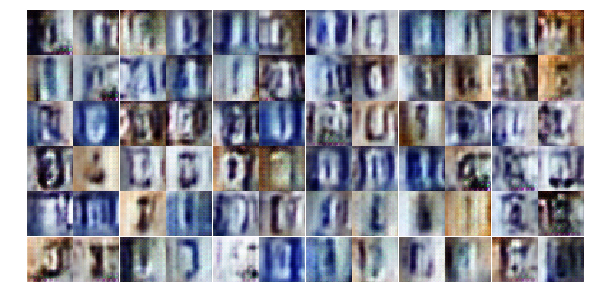

Epoch 5/25... Discriminator Loss: 1.3534... Generator Loss: 0.6396
Epoch 5/25... Discriminator Loss: 1.3479... Generator Loss: 0.8157
Epoch 5/25... Discriminator Loss: 1.3742... Generator Loss: 0.6684
Epoch 5/25... Discriminator Loss: 1.3593... Generator Loss: 0.7125
Epoch 5/25... Discriminator Loss: 1.3532... Generator Loss: 0.7341
Epoch 5/25... Discriminator Loss: 1.3002... Generator Loss: 0.7273
Epoch 6/25... Discriminator Loss: 1.3715... Generator Loss: 0.8306
Epoch 6/25... Discriminator Loss: 1.2843... Generator Loss: 0.7481
Epoch 6/25... Discriminator Loss: 1.4081... Generator Loss: 0.8596
Epoch 6/25... Discriminator Loss: 1.3746... Generator Loss: 0.7971


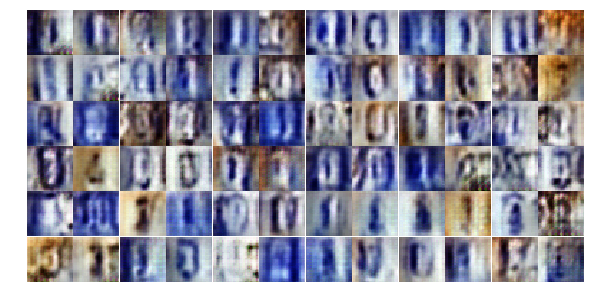

Epoch 6/25... Discriminator Loss: 1.3489... Generator Loss: 0.8042
Epoch 6/25... Discriminator Loss: 1.3755... Generator Loss: 0.7304
Epoch 6/25... Discriminator Loss: 1.3683... Generator Loss: 0.7498
Epoch 6/25... Discriminator Loss: 1.3567... Generator Loss: 0.7780
Epoch 6/25... Discriminator Loss: 1.3866... Generator Loss: 0.7641
Epoch 6/25... Discriminator Loss: 1.3496... Generator Loss: 0.8161
Epoch 6/25... Discriminator Loss: 1.3529... Generator Loss: 0.7059
Epoch 6/25... Discriminator Loss: 1.4028... Generator Loss: 0.7044
Epoch 6/25... Discriminator Loss: 1.3483... Generator Loss: 0.6496
Epoch 6/25... Discriminator Loss: 1.3267... Generator Loss: 0.8393


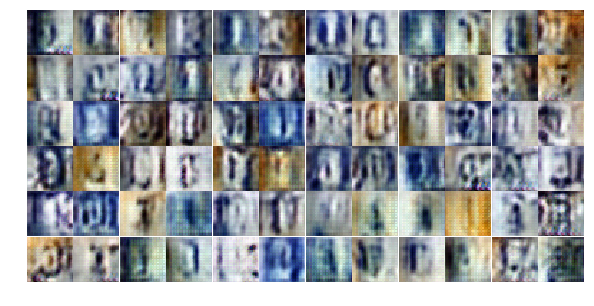

Epoch 6/25... Discriminator Loss: 1.4151... Generator Loss: 0.7557
Epoch 6/25... Discriminator Loss: 1.3625... Generator Loss: 0.7641
Epoch 6/25... Discriminator Loss: 1.3360... Generator Loss: 0.7678
Epoch 6/25... Discriminator Loss: 1.3469... Generator Loss: 0.7913
Epoch 6/25... Discriminator Loss: 1.3048... Generator Loss: 0.7166
Epoch 6/25... Discriminator Loss: 1.3123... Generator Loss: 0.7804
Epoch 6/25... Discriminator Loss: 1.3765... Generator Loss: 0.7709
Epoch 6/25... Discriminator Loss: 1.3489... Generator Loss: 0.7387
Epoch 6/25... Discriminator Loss: 1.2999... Generator Loss: 0.7291
Epoch 6/25... Discriminator Loss: 1.3306... Generator Loss: 0.7382


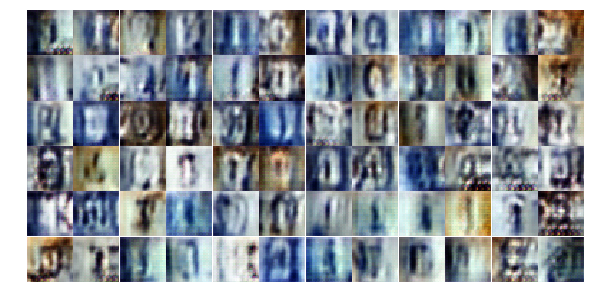

Epoch 6/25... Discriminator Loss: 1.3141... Generator Loss: 0.7133
Epoch 6/25... Discriminator Loss: 1.3992... Generator Loss: 0.6757
Epoch 6/25... Discriminator Loss: 1.3504... Generator Loss: 0.7733
Epoch 6/25... Discriminator Loss: 1.3584... Generator Loss: 0.7190
Epoch 6/25... Discriminator Loss: 1.3414... Generator Loss: 0.7059
Epoch 6/25... Discriminator Loss: 1.3576... Generator Loss: 0.7576
Epoch 6/25... Discriminator Loss: 1.3355... Generator Loss: 0.7024
Epoch 6/25... Discriminator Loss: 1.2948... Generator Loss: 0.7879
Epoch 6/25... Discriminator Loss: 1.3772... Generator Loss: 0.7552
Epoch 6/25... Discriminator Loss: 1.3362... Generator Loss: 0.7519


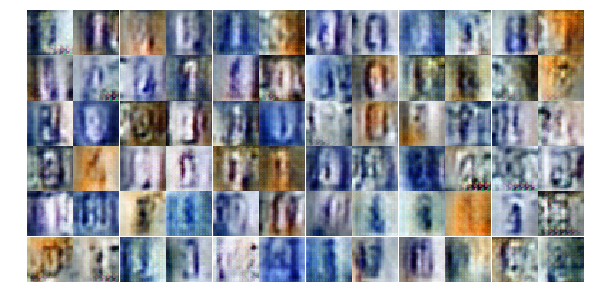

Epoch 6/25... Discriminator Loss: 1.4085... Generator Loss: 0.7392
Epoch 6/25... Discriminator Loss: 1.4145... Generator Loss: 0.6860
Epoch 6/25... Discriminator Loss: 1.2936... Generator Loss: 0.8107
Epoch 6/25... Discriminator Loss: 1.3483... Generator Loss: 0.7195
Epoch 6/25... Discriminator Loss: 1.3231... Generator Loss: 0.7309
Epoch 6/25... Discriminator Loss: 1.3288... Generator Loss: 0.7289
Epoch 6/25... Discriminator Loss: 1.3229... Generator Loss: 0.7354
Epoch 6/25... Discriminator Loss: 1.3444... Generator Loss: 0.7303
Epoch 6/25... Discriminator Loss: 1.3580... Generator Loss: 0.7106
Epoch 6/25... Discriminator Loss: 1.3802... Generator Loss: 0.7584


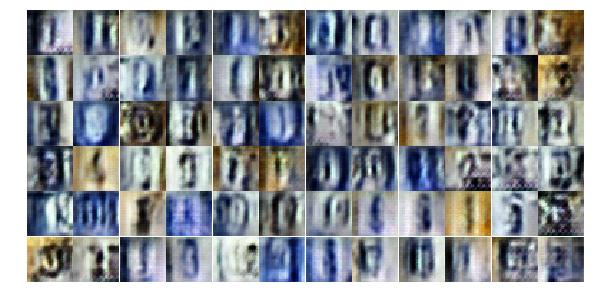

Epoch 6/25... Discriminator Loss: 1.3775... Generator Loss: 0.7375
Epoch 6/25... Discriminator Loss: 1.3612... Generator Loss: 0.7202
Epoch 6/25... Discriminator Loss: 1.3426... Generator Loss: 0.7418
Epoch 6/25... Discriminator Loss: 1.3341... Generator Loss: 0.7869
Epoch 6/25... Discriminator Loss: 1.3394... Generator Loss: 0.7236
Epoch 6/25... Discriminator Loss: 1.3534... Generator Loss: 0.6825
Epoch 6/25... Discriminator Loss: 1.4067... Generator Loss: 0.6481
Epoch 6/25... Discriminator Loss: 1.3279... Generator Loss: 0.8101
Epoch 6/25... Discriminator Loss: 1.3381... Generator Loss: 0.7161
Epoch 6/25... Discriminator Loss: 1.3484... Generator Loss: 0.6883


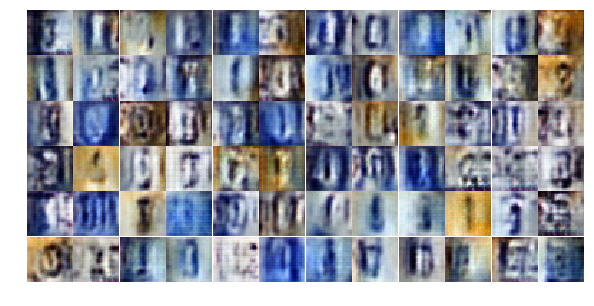

Epoch 6/25... Discriminator Loss: 1.3445... Generator Loss: 0.7686
Epoch 6/25... Discriminator Loss: 1.5278... Generator Loss: 0.9251
Epoch 6/25... Discriminator Loss: 1.3894... Generator Loss: 0.7159
Epoch 7/25... Discriminator Loss: 1.4005... Generator Loss: 0.6972
Epoch 7/25... Discriminator Loss: 1.4040... Generator Loss: 0.7612
Epoch 7/25... Discriminator Loss: 1.3109... Generator Loss: 0.7283
Epoch 7/25... Discriminator Loss: 1.3042... Generator Loss: 0.6669
Epoch 7/25... Discriminator Loss: 1.3468... Generator Loss: 0.6774
Epoch 7/25... Discriminator Loss: 1.2529... Generator Loss: 0.8063
Epoch 7/25... Discriminator Loss: 1.3006... Generator Loss: 0.8092


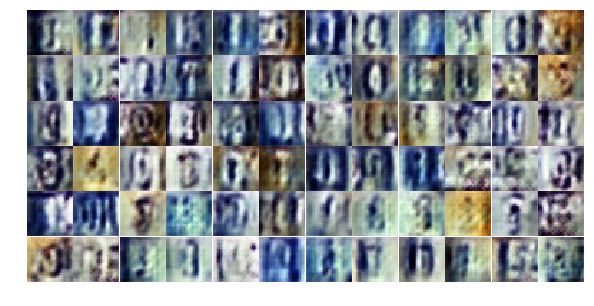

Epoch 7/25... Discriminator Loss: 1.2647... Generator Loss: 0.6763
Epoch 7/25... Discriminator Loss: 1.2870... Generator Loss: 0.7492
Epoch 7/25... Discriminator Loss: 1.2848... Generator Loss: 0.7164
Epoch 7/25... Discriminator Loss: 1.3578... Generator Loss: 0.7298
Epoch 7/25... Discriminator Loss: 1.3706... Generator Loss: 0.7353
Epoch 7/25... Discriminator Loss: 1.3137... Generator Loss: 0.7104
Epoch 7/25... Discriminator Loss: 1.3739... Generator Loss: 0.6677
Epoch 7/25... Discriminator Loss: 1.3247... Generator Loss: 0.7414
Epoch 7/25... Discriminator Loss: 1.3441... Generator Loss: 0.7730
Epoch 7/25... Discriminator Loss: 1.3122... Generator Loss: 0.6810


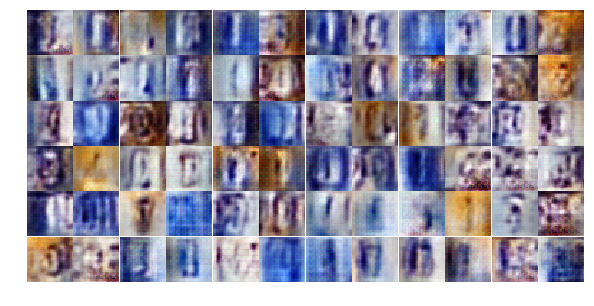

Epoch 7/25... Discriminator Loss: 1.3852... Generator Loss: 0.7044
Epoch 7/25... Discriminator Loss: 1.3231... Generator Loss: 0.7332
Epoch 7/25... Discriminator Loss: 1.3080... Generator Loss: 0.7909
Epoch 7/25... Discriminator Loss: 1.3017... Generator Loss: 0.7252
Epoch 7/25... Discriminator Loss: 1.3681... Generator Loss: 0.7143
Epoch 7/25... Discriminator Loss: 1.3314... Generator Loss: 0.7790
Epoch 7/25... Discriminator Loss: 1.3898... Generator Loss: 0.6797
Epoch 7/25... Discriminator Loss: 1.3537... Generator Loss: 0.7478
Epoch 7/25... Discriminator Loss: 1.3070... Generator Loss: 0.6498
Epoch 7/25... Discriminator Loss: 1.3752... Generator Loss: 0.6919


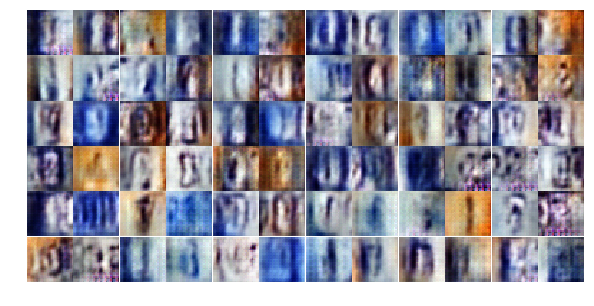

Epoch 7/25... Discriminator Loss: 1.3749... Generator Loss: 0.7131
Epoch 7/25... Discriminator Loss: 1.3589... Generator Loss: 0.6274
Epoch 7/25... Discriminator Loss: 1.3117... Generator Loss: 0.7388
Epoch 7/25... Discriminator Loss: 1.3457... Generator Loss: 0.7271
Epoch 7/25... Discriminator Loss: 1.3756... Generator Loss: 0.6995
Epoch 7/25... Discriminator Loss: 1.3509... Generator Loss: 0.7244
Epoch 7/25... Discriminator Loss: 1.3689... Generator Loss: 0.7864
Epoch 7/25... Discriminator Loss: 1.2971... Generator Loss: 0.7939
Epoch 7/25... Discriminator Loss: 1.3581... Generator Loss: 0.6902
Epoch 7/25... Discriminator Loss: 1.3419... Generator Loss: 0.5917


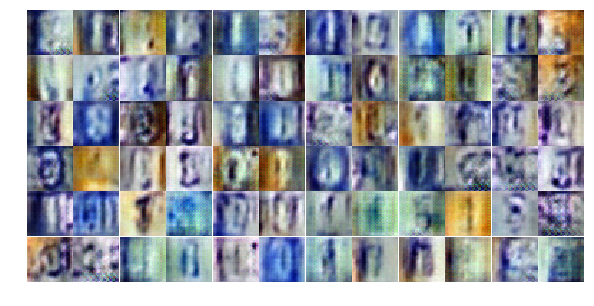

Epoch 7/25... Discriminator Loss: 1.3964... Generator Loss: 0.6868
Epoch 7/25... Discriminator Loss: 1.3527... Generator Loss: 0.7413
Epoch 7/25... Discriminator Loss: 1.3637... Generator Loss: 0.6972
Epoch 7/25... Discriminator Loss: 1.3570... Generator Loss: 0.7522
Epoch 7/25... Discriminator Loss: 1.3550... Generator Loss: 0.7833
Epoch 7/25... Discriminator Loss: 1.3788... Generator Loss: 0.6794
Epoch 7/25... Discriminator Loss: 1.3810... Generator Loss: 0.7780
Epoch 7/25... Discriminator Loss: 1.3766... Generator Loss: 0.6913
Epoch 7/25... Discriminator Loss: 1.2913... Generator Loss: 0.7657
Epoch 7/25... Discriminator Loss: 1.3834... Generator Loss: 0.7339


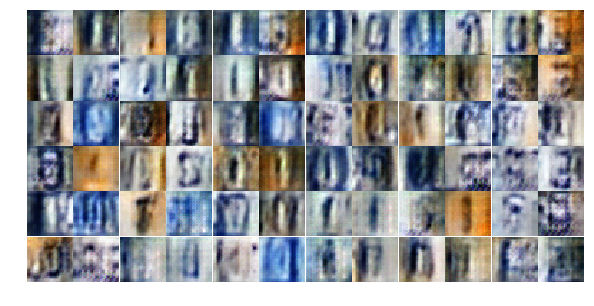

Epoch 7/25... Discriminator Loss: 1.3073... Generator Loss: 0.6857
Epoch 7/25... Discriminator Loss: 1.3242... Generator Loss: 0.7299
Epoch 7/25... Discriminator Loss: 1.3419... Generator Loss: 0.6961
Epoch 7/25... Discriminator Loss: 1.3314... Generator Loss: 0.7582
Epoch 7/25... Discriminator Loss: 1.3431... Generator Loss: 0.7105
Epoch 7/25... Discriminator Loss: 1.3375... Generator Loss: 0.6898
Epoch 7/25... Discriminator Loss: 1.3664... Generator Loss: 0.8016
Epoch 7/25... Discriminator Loss: 1.3406... Generator Loss: 0.5971
Epoch 7/25... Discriminator Loss: 1.4344... Generator Loss: 0.6871
Epoch 7/25... Discriminator Loss: 1.4068... Generator Loss: 0.7414


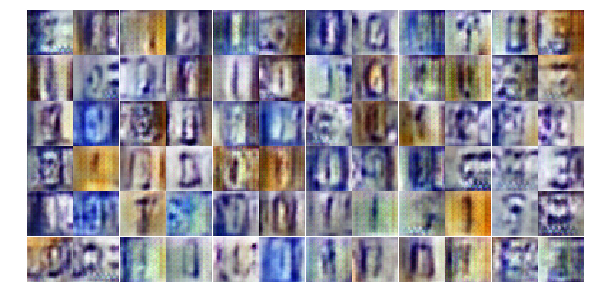

Epoch 7/25... Discriminator Loss: 1.3523... Generator Loss: 0.7430
Epoch 8/25... Discriminator Loss: 1.3495... Generator Loss: 0.7190
Epoch 8/25... Discriminator Loss: 1.3358... Generator Loss: 0.7447
Epoch 8/25... Discriminator Loss: 1.3588... Generator Loss: 0.6362
Epoch 8/25... Discriminator Loss: 1.3333... Generator Loss: 0.7526
Epoch 8/25... Discriminator Loss: 1.3358... Generator Loss: 0.6944
Epoch 8/25... Discriminator Loss: 1.3629... Generator Loss: 0.7102
Epoch 8/25... Discriminator Loss: 1.3546... Generator Loss: 0.6592
Epoch 8/25... Discriminator Loss: 1.3300... Generator Loss: 0.7048
Epoch 8/25... Discriminator Loss: 1.3796... Generator Loss: 0.7019


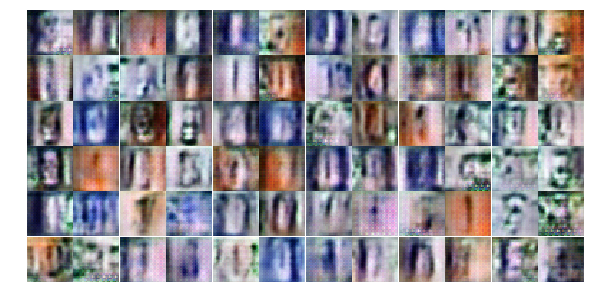

Epoch 8/25... Discriminator Loss: 1.3078... Generator Loss: 0.7785
Epoch 8/25... Discriminator Loss: 1.3556... Generator Loss: 0.7282
Epoch 8/25... Discriminator Loss: 1.3734... Generator Loss: 0.6993
Epoch 8/25... Discriminator Loss: 1.3669... Generator Loss: 0.7432
Epoch 8/25... Discriminator Loss: 1.3663... Generator Loss: 0.6967
Epoch 8/25... Discriminator Loss: 1.3387... Generator Loss: 0.7637
Epoch 8/25... Discriminator Loss: 1.3761... Generator Loss: 0.7471
Epoch 8/25... Discriminator Loss: 1.3133... Generator Loss: 0.6939
Epoch 8/25... Discriminator Loss: 1.4072... Generator Loss: 0.7303
Epoch 8/25... Discriminator Loss: 1.3739... Generator Loss: 0.7511


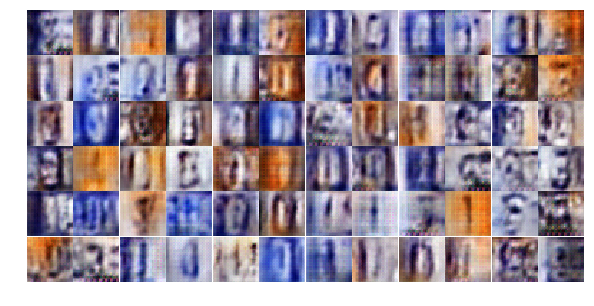

Epoch 8/25... Discriminator Loss: 1.3811... Generator Loss: 0.7524
Epoch 8/25... Discriminator Loss: 1.4279... Generator Loss: 0.7171
Epoch 8/25... Discriminator Loss: 1.3920... Generator Loss: 0.7223
Epoch 8/25... Discriminator Loss: 1.4808... Generator Loss: 0.6718
Epoch 8/25... Discriminator Loss: 1.3724... Generator Loss: 0.8615
Epoch 8/25... Discriminator Loss: 1.3829... Generator Loss: 0.8582
Epoch 8/25... Discriminator Loss: 1.3377... Generator Loss: 0.7107
Epoch 8/25... Discriminator Loss: 1.3220... Generator Loss: 0.8158
Epoch 8/25... Discriminator Loss: 1.3202... Generator Loss: 0.6896
Epoch 8/25... Discriminator Loss: 1.3506... Generator Loss: 0.7019


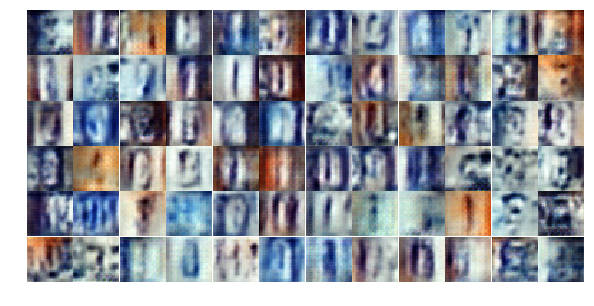

Epoch 8/25... Discriminator Loss: 1.3848... Generator Loss: 0.6590
Epoch 8/25... Discriminator Loss: 1.3089... Generator Loss: 0.7083
Epoch 8/25... Discriminator Loss: 1.3732... Generator Loss: 0.6698
Epoch 8/25... Discriminator Loss: 1.3311... Generator Loss: 0.6830
Epoch 8/25... Discriminator Loss: 1.3711... Generator Loss: 0.7406
Epoch 8/25... Discriminator Loss: 1.3558... Generator Loss: 0.7310
Epoch 8/25... Discriminator Loss: 1.4087... Generator Loss: 0.7429
Epoch 8/25... Discriminator Loss: 1.3518... Generator Loss: 0.7173
Epoch 8/25... Discriminator Loss: 1.4622... Generator Loss: 0.6160
Epoch 8/25... Discriminator Loss: 1.3714... Generator Loss: 0.6799


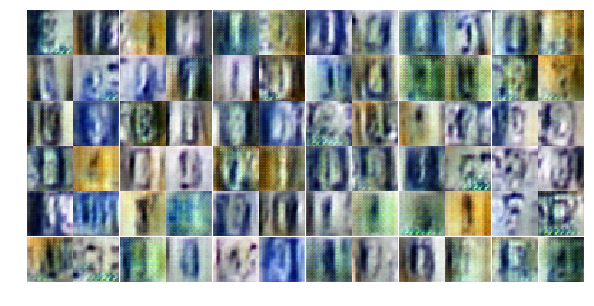

Epoch 8/25... Discriminator Loss: 1.4231... Generator Loss: 0.7404
Epoch 8/25... Discriminator Loss: 1.3663... Generator Loss: 0.6546
Epoch 8/25... Discriminator Loss: 1.3438... Generator Loss: 0.6758
Epoch 8/25... Discriminator Loss: 1.3605... Generator Loss: 0.7103
Epoch 8/25... Discriminator Loss: 1.2844... Generator Loss: 0.8049
Epoch 8/25... Discriminator Loss: 1.3183... Generator Loss: 0.7630
Epoch 8/25... Discriminator Loss: 1.4004... Generator Loss: 0.7566
Epoch 8/25... Discriminator Loss: 1.3682... Generator Loss: 0.6980
Epoch 8/25... Discriminator Loss: 1.3483... Generator Loss: 0.7325
Epoch 8/25... Discriminator Loss: 1.3091... Generator Loss: 0.7755


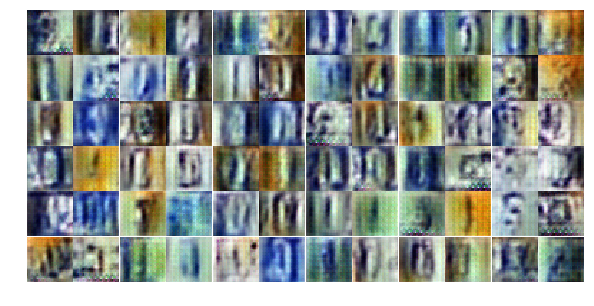

Epoch 8/25... Discriminator Loss: 1.3642... Generator Loss: 0.7221
Epoch 8/25... Discriminator Loss: 1.3226... Generator Loss: 0.7211
Epoch 8/25... Discriminator Loss: 1.3075... Generator Loss: 0.7158
Epoch 8/25... Discriminator Loss: 1.4329... Generator Loss: 0.7335
Epoch 8/25... Discriminator Loss: 1.3799... Generator Loss: 0.6693
Epoch 8/25... Discriminator Loss: 1.3679... Generator Loss: 0.7456
Epoch 8/25... Discriminator Loss: 1.3181... Generator Loss: 0.7743
Epoch 8/25... Discriminator Loss: 1.3572... Generator Loss: 0.7437
Epoch 9/25... Discriminator Loss: 1.3833... Generator Loss: 0.7378
Epoch 9/25... Discriminator Loss: 1.3857... Generator Loss: 0.7324


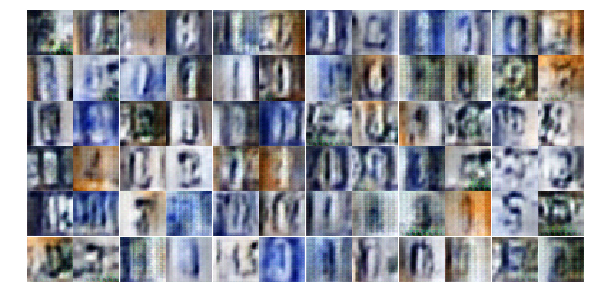

Epoch 9/25... Discriminator Loss: 1.3277... Generator Loss: 0.6885
Epoch 9/25... Discriminator Loss: 1.3284... Generator Loss: 0.7692
Epoch 9/25... Discriminator Loss: 1.3557... Generator Loss: 0.6917
Epoch 9/25... Discriminator Loss: 1.3647... Generator Loss: 0.7440
Epoch 9/25... Discriminator Loss: 1.3549... Generator Loss: 0.7718
Epoch 9/25... Discriminator Loss: 1.3350... Generator Loss: 0.6624
Epoch 9/25... Discriminator Loss: 1.3289... Generator Loss: 0.7444
Epoch 9/25... Discriminator Loss: 1.3704... Generator Loss: 0.6832
Epoch 9/25... Discriminator Loss: 1.3481... Generator Loss: 0.6365
Epoch 9/25... Discriminator Loss: 1.3694... Generator Loss: 0.6997


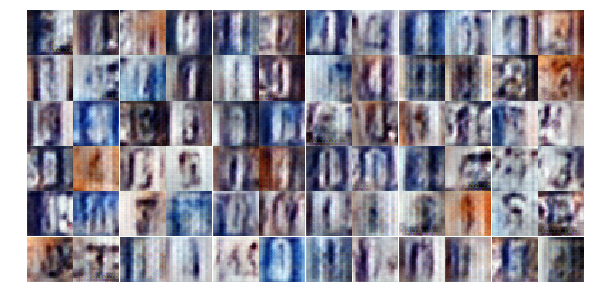

Epoch 9/25... Discriminator Loss: 1.3662... Generator Loss: 0.7398
Epoch 9/25... Discriminator Loss: 1.3199... Generator Loss: 0.6899
Epoch 9/25... Discriminator Loss: 1.4194... Generator Loss: 0.6050
Epoch 9/25... Discriminator Loss: 1.3669... Generator Loss: 0.7689
Epoch 9/25... Discriminator Loss: 1.3390... Generator Loss: 0.7316
Epoch 9/25... Discriminator Loss: 1.3578... Generator Loss: 0.7018
Epoch 9/25... Discriminator Loss: 1.3402... Generator Loss: 0.7630
Epoch 9/25... Discriminator Loss: 1.3057... Generator Loss: 0.7161
Epoch 9/25... Discriminator Loss: 1.3277... Generator Loss: 0.7500
Epoch 9/25... Discriminator Loss: 1.3650... Generator Loss: 0.7219


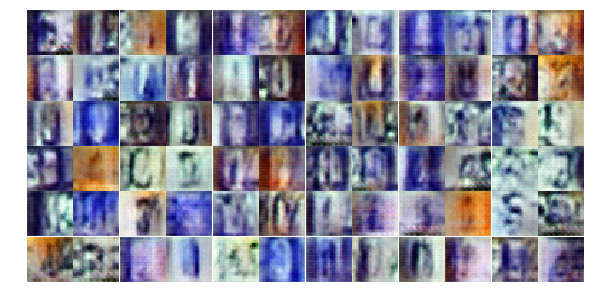

Epoch 9/25... Discriminator Loss: 1.3814... Generator Loss: 0.7157
Epoch 9/25... Discriminator Loss: 1.3432... Generator Loss: 0.7001
Epoch 9/25... Discriminator Loss: 1.3313... Generator Loss: 0.6684
Epoch 9/25... Discriminator Loss: 1.4289... Generator Loss: 0.5913
Epoch 9/25... Discriminator Loss: 1.3565... Generator Loss: 0.8395
Epoch 9/25... Discriminator Loss: 1.3224... Generator Loss: 0.7383
Epoch 9/25... Discriminator Loss: 1.3250... Generator Loss: 0.7231
Epoch 9/25... Discriminator Loss: 1.3496... Generator Loss: 0.8140
Epoch 9/25... Discriminator Loss: 1.3476... Generator Loss: 0.7465
Epoch 9/25... Discriminator Loss: 1.3866... Generator Loss: 0.7228


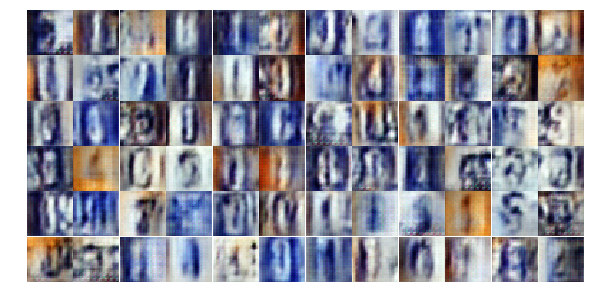

Epoch 9/25... Discriminator Loss: 1.3876... Generator Loss: 0.7800
Epoch 9/25... Discriminator Loss: 1.3701... Generator Loss: 0.7543
Epoch 9/25... Discriminator Loss: 1.3728... Generator Loss: 0.7074
Epoch 9/25... Discriminator Loss: 1.3753... Generator Loss: 0.7602
Epoch 9/25... Discriminator Loss: 1.3329... Generator Loss: 0.7182
Epoch 9/25... Discriminator Loss: 1.3518... Generator Loss: 0.6945
Epoch 9/25... Discriminator Loss: 1.3710... Generator Loss: 0.7037
Epoch 9/25... Discriminator Loss: 1.3435... Generator Loss: 0.7635
Epoch 9/25... Discriminator Loss: 1.3867... Generator Loss: 0.7566
Epoch 9/25... Discriminator Loss: 1.3620... Generator Loss: 0.7031


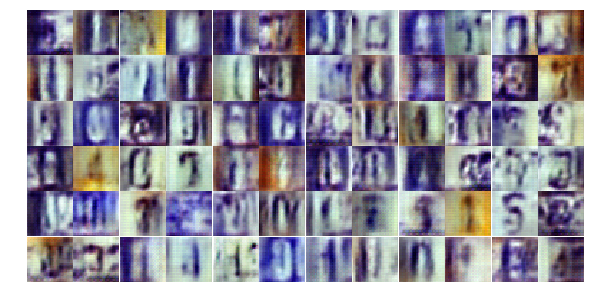

Epoch 9/25... Discriminator Loss: 1.3880... Generator Loss: 0.7019
Epoch 9/25... Discriminator Loss: 1.3611... Generator Loss: 0.6572
Epoch 9/25... Discriminator Loss: 1.3448... Generator Loss: 0.8016
Epoch 9/25... Discriminator Loss: 1.3819... Generator Loss: 0.6392
Epoch 9/25... Discriminator Loss: 1.3364... Generator Loss: 0.7522
Epoch 9/25... Discriminator Loss: 1.4036... Generator Loss: 0.6572
Epoch 9/25... Discriminator Loss: 1.3057... Generator Loss: 0.7283
Epoch 9/25... Discriminator Loss: 1.4157... Generator Loss: 0.6938
Epoch 9/25... Discriminator Loss: 1.3402... Generator Loss: 0.7544
Epoch 9/25... Discriminator Loss: 1.3668... Generator Loss: 0.7285


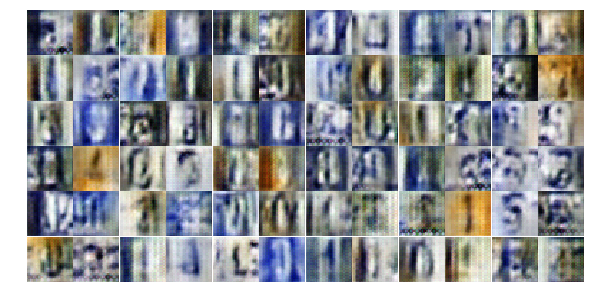

Epoch 9/25... Discriminator Loss: 1.4045... Generator Loss: 0.7012
Epoch 9/25... Discriminator Loss: 1.3409... Generator Loss: 0.7322
Epoch 9/25... Discriminator Loss: 1.2987... Generator Loss: 0.7220
Epoch 9/25... Discriminator Loss: 1.3550... Generator Loss: 0.7634
Epoch 9/25... Discriminator Loss: 1.3227... Generator Loss: 0.7419
Epoch 10/25... Discriminator Loss: 1.3511... Generator Loss: 0.7459
Epoch 10/25... Discriminator Loss: 1.2967... Generator Loss: 0.7235
Epoch 10/25... Discriminator Loss: 1.3334... Generator Loss: 0.7113
Epoch 10/25... Discriminator Loss: 1.3802... Generator Loss: 0.7001
Epoch 10/25... Discriminator Loss: 1.3171... Generator Loss: 0.7578


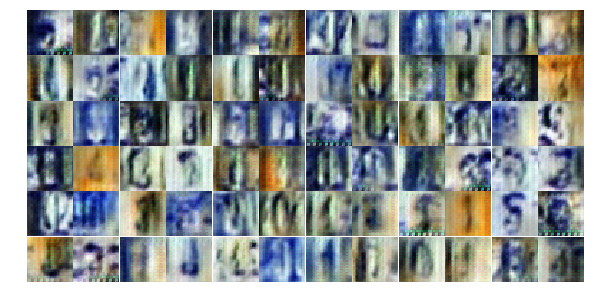

Epoch 10/25... Discriminator Loss: 1.3458... Generator Loss: 0.7884
Epoch 10/25... Discriminator Loss: 1.3446... Generator Loss: 0.7687
Epoch 10/25... Discriminator Loss: 1.3304... Generator Loss: 0.6981
Epoch 10/25... Discriminator Loss: 1.3183... Generator Loss: 0.7244
Epoch 10/25... Discriminator Loss: 1.3101... Generator Loss: 0.7172
Epoch 10/25... Discriminator Loss: 1.3598... Generator Loss: 0.7191
Epoch 10/25... Discriminator Loss: 1.3154... Generator Loss: 0.8225
Epoch 10/25... Discriminator Loss: 1.3741... Generator Loss: 0.8028
Epoch 10/25... Discriminator Loss: 1.3532... Generator Loss: 0.7289
Epoch 10/25... Discriminator Loss: 1.3477... Generator Loss: 0.7325


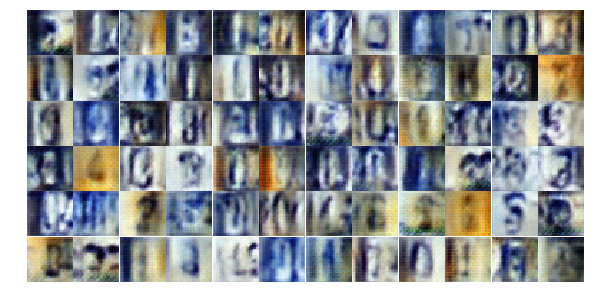

Epoch 10/25... Discriminator Loss: 1.3202... Generator Loss: 0.7316
Epoch 10/25... Discriminator Loss: 1.3577... Generator Loss: 0.7532
Epoch 10/25... Discriminator Loss: 1.3358... Generator Loss: 0.7289
Epoch 10/25... Discriminator Loss: 1.3960... Generator Loss: 0.6676
Epoch 10/25... Discriminator Loss: 1.3353... Generator Loss: 0.8158
Epoch 10/25... Discriminator Loss: 1.3935... Generator Loss: 0.7440
Epoch 10/25... Discriminator Loss: 1.3970... Generator Loss: 0.6841
Epoch 10/25... Discriminator Loss: 1.3552... Generator Loss: 0.6740
Epoch 10/25... Discriminator Loss: 1.3516... Generator Loss: 0.7101
Epoch 10/25... Discriminator Loss: 1.3568... Generator Loss: 0.7096


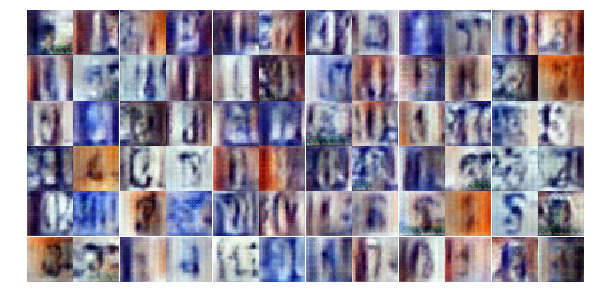

Epoch 10/25... Discriminator Loss: 1.4021... Generator Loss: 0.7983
Epoch 10/25... Discriminator Loss: 1.3389... Generator Loss: 0.6718
Epoch 10/25... Discriminator Loss: 1.3903... Generator Loss: 0.6561
Epoch 10/25... Discriminator Loss: 1.3397... Generator Loss: 0.6852
Epoch 10/25... Discriminator Loss: 1.3788... Generator Loss: 0.7354
Epoch 10/25... Discriminator Loss: 1.3672... Generator Loss: 0.7197
Epoch 10/25... Discriminator Loss: 1.2918... Generator Loss: 0.6708
Epoch 10/25... Discriminator Loss: 1.4045... Generator Loss: 0.7901
Epoch 10/25... Discriminator Loss: 1.4366... Generator Loss: 0.7152
Epoch 10/25... Discriminator Loss: 1.3633... Generator Loss: 0.7705


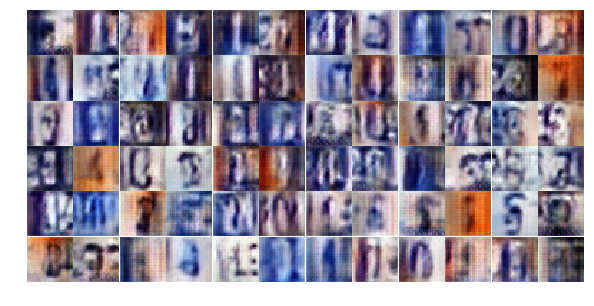

Epoch 10/25... Discriminator Loss: 1.4006... Generator Loss: 0.7016
Epoch 10/25... Discriminator Loss: 1.3458... Generator Loss: 0.7461
Epoch 10/25... Discriminator Loss: 1.4042... Generator Loss: 0.6541
Epoch 10/25... Discriminator Loss: 1.3443... Generator Loss: 0.7136
Epoch 10/25... Discriminator Loss: 1.3187... Generator Loss: 0.7233
Epoch 10/25... Discriminator Loss: 1.3679... Generator Loss: 0.7384
Epoch 10/25... Discriminator Loss: 1.3614... Generator Loss: 0.7226
Epoch 10/25... Discriminator Loss: 1.3572... Generator Loss: 0.7244
Epoch 10/25... Discriminator Loss: 1.3600... Generator Loss: 0.7690
Epoch 10/25... Discriminator Loss: 1.3085... Generator Loss: 0.7235


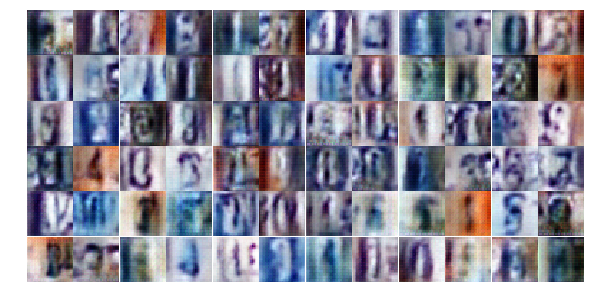

Epoch 10/25... Discriminator Loss: 1.3493... Generator Loss: 0.7828
Epoch 10/25... Discriminator Loss: 1.3401... Generator Loss: 0.7422
Epoch 10/25... Discriminator Loss: 1.3800... Generator Loss: 0.6976
Epoch 10/25... Discriminator Loss: 1.3668... Generator Loss: 0.7522
Epoch 10/25... Discriminator Loss: 1.3681... Generator Loss: 0.7857
Epoch 10/25... Discriminator Loss: 1.3297... Generator Loss: 0.7151
Epoch 10/25... Discriminator Loss: 1.4041... Generator Loss: 0.6840
Epoch 10/25... Discriminator Loss: 1.3342... Generator Loss: 0.7048
Epoch 10/25... Discriminator Loss: 1.3742... Generator Loss: 0.7639
Epoch 10/25... Discriminator Loss: 1.3623... Generator Loss: 0.7109


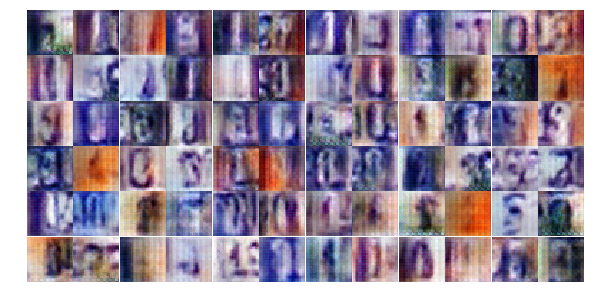

Epoch 10/25... Discriminator Loss: 1.4427... Generator Loss: 0.7309
Epoch 10/25... Discriminator Loss: 1.4054... Generator Loss: 0.5982
Epoch 10/25... Discriminator Loss: 1.3409... Generator Loss: 0.7010
Epoch 11/25... Discriminator Loss: 1.3735... Generator Loss: 0.6304
Epoch 11/25... Discriminator Loss: 1.3493... Generator Loss: 0.7325
Epoch 11/25... Discriminator Loss: 1.3759... Generator Loss: 0.7099
Epoch 11/25... Discriminator Loss: 1.3634... Generator Loss: 0.7408
Epoch 11/25... Discriminator Loss: 1.3693... Generator Loss: 0.6442
Epoch 11/25... Discriminator Loss: 1.3842... Generator Loss: 0.7093
Epoch 11/25... Discriminator Loss: 1.3581... Generator Loss: 0.7501


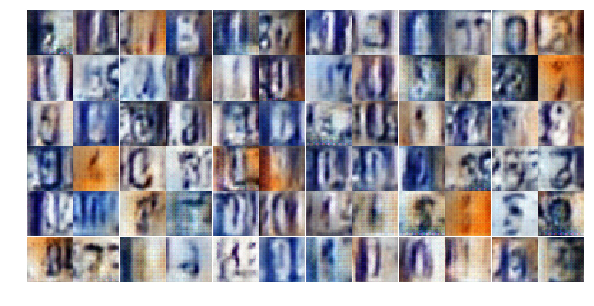

Epoch 11/25... Discriminator Loss: 1.3283... Generator Loss: 0.7062
Epoch 11/25... Discriminator Loss: 1.3428... Generator Loss: 0.7176
Epoch 11/25... Discriminator Loss: 1.3344... Generator Loss: 0.7087
Epoch 11/25... Discriminator Loss: 1.4056... Generator Loss: 0.6706
Epoch 11/25... Discriminator Loss: 1.3565... Generator Loss: 0.7324
Epoch 11/25... Discriminator Loss: 1.3674... Generator Loss: 0.7069
Epoch 11/25... Discriminator Loss: 1.3290... Generator Loss: 0.6902
Epoch 11/25... Discriminator Loss: 1.2693... Generator Loss: 0.7102
Epoch 11/25... Discriminator Loss: 1.3663... Generator Loss: 0.7404
Epoch 11/25... Discriminator Loss: 1.3248... Generator Loss: 0.7064


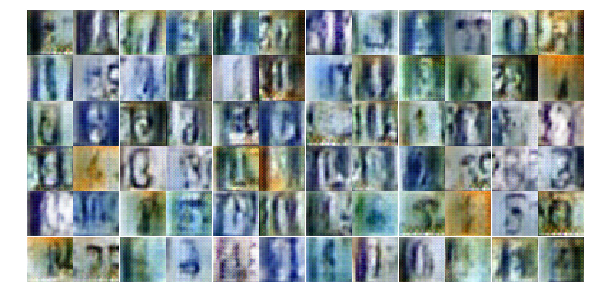

Epoch 11/25... Discriminator Loss: 1.4109... Generator Loss: 0.6797
Epoch 11/25... Discriminator Loss: 1.3315... Generator Loss: 0.6804
Epoch 11/25... Discriminator Loss: 1.4232... Generator Loss: 0.6627
Epoch 11/25... Discriminator Loss: 1.3444... Generator Loss: 0.7036
Epoch 11/25... Discriminator Loss: 1.3386... Generator Loss: 0.7119
Epoch 11/25... Discriminator Loss: 1.3487... Generator Loss: 0.7592
Epoch 11/25... Discriminator Loss: 1.3976... Generator Loss: 0.7528
Epoch 11/25... Discriminator Loss: 1.3764... Generator Loss: 0.7333
Epoch 11/25... Discriminator Loss: 1.3596... Generator Loss: 0.7316
Epoch 11/25... Discriminator Loss: 1.3405... Generator Loss: 0.7570


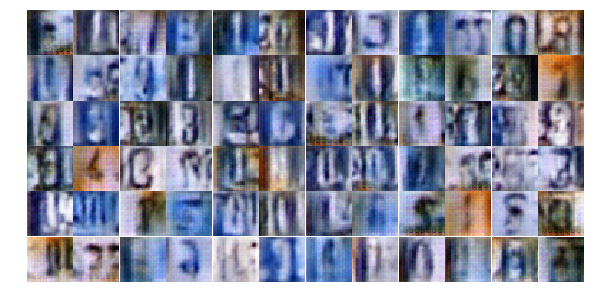

Epoch 11/25... Discriminator Loss: 1.3935... Generator Loss: 0.7519
Epoch 11/25... Discriminator Loss: 1.3638... Generator Loss: 0.7045
Epoch 11/25... Discriminator Loss: 1.3548... Generator Loss: 0.7059
Epoch 11/25... Discriminator Loss: 1.3372... Generator Loss: 0.7114
Epoch 11/25... Discriminator Loss: 1.3851... Generator Loss: 0.6896
Epoch 11/25... Discriminator Loss: 1.3738... Generator Loss: 0.6739
Epoch 11/25... Discriminator Loss: 1.3688... Generator Loss: 0.7316
Epoch 11/25... Discriminator Loss: 1.3868... Generator Loss: 0.7172
Epoch 11/25... Discriminator Loss: 1.3287... Generator Loss: 0.7254
Epoch 11/25... Discriminator Loss: 1.3396... Generator Loss: 0.7585


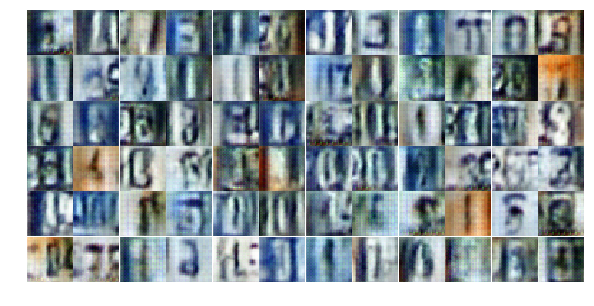

Epoch 11/25... Discriminator Loss: 1.3108... Generator Loss: 0.6559
Epoch 11/25... Discriminator Loss: 1.3242... Generator Loss: 0.7558
Epoch 11/25... Discriminator Loss: 1.3812... Generator Loss: 0.7488
Epoch 11/25... Discriminator Loss: 1.3775... Generator Loss: 0.7126
Epoch 11/25... Discriminator Loss: 1.3732... Generator Loss: 0.6715
Epoch 11/25... Discriminator Loss: 1.3288... Generator Loss: 0.6940
Epoch 11/25... Discriminator Loss: 1.3599... Generator Loss: 0.7640
Epoch 11/25... Discriminator Loss: 1.3734... Generator Loss: 0.7445
Epoch 11/25... Discriminator Loss: 1.4015... Generator Loss: 0.6549
Epoch 11/25... Discriminator Loss: 1.3590... Generator Loss: 0.7053


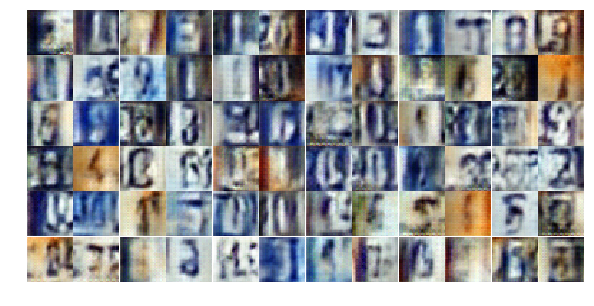

Epoch 11/25... Discriminator Loss: 1.3748... Generator Loss: 0.7069
Epoch 11/25... Discriminator Loss: 1.3996... Generator Loss: 0.7531
Epoch 11/25... Discriminator Loss: 1.4517... Generator Loss: 0.6387
Epoch 11/25... Discriminator Loss: 1.3633... Generator Loss: 0.8327
Epoch 11/25... Discriminator Loss: 1.3578... Generator Loss: 0.7643
Epoch 11/25... Discriminator Loss: 1.3880... Generator Loss: 0.6698
Epoch 11/25... Discriminator Loss: 1.3815... Generator Loss: 0.6735
Epoch 11/25... Discriminator Loss: 1.3609... Generator Loss: 0.7153
Epoch 11/25... Discriminator Loss: 1.3250... Generator Loss: 0.8380
Epoch 11/25... Discriminator Loss: 1.3561... Generator Loss: 0.6910


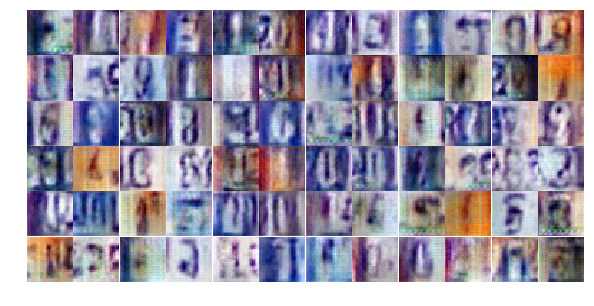

Epoch 12/25... Discriminator Loss: 1.3571... Generator Loss: 0.7496
Epoch 12/25... Discriminator Loss: 1.3737... Generator Loss: 0.7691
Epoch 12/25... Discriminator Loss: 1.3829... Generator Loss: 0.6213
Epoch 12/25... Discriminator Loss: 1.3782... Generator Loss: 0.7163
Epoch 12/25... Discriminator Loss: 1.3516... Generator Loss: 0.7552
Epoch 12/25... Discriminator Loss: 1.3332... Generator Loss: 0.7268
Epoch 12/25... Discriminator Loss: 1.3664... Generator Loss: 0.7014
Epoch 12/25... Discriminator Loss: 1.3990... Generator Loss: 0.6958
Epoch 12/25... Discriminator Loss: 1.3771... Generator Loss: 0.7048
Epoch 12/25... Discriminator Loss: 1.3635... Generator Loss: 0.7158


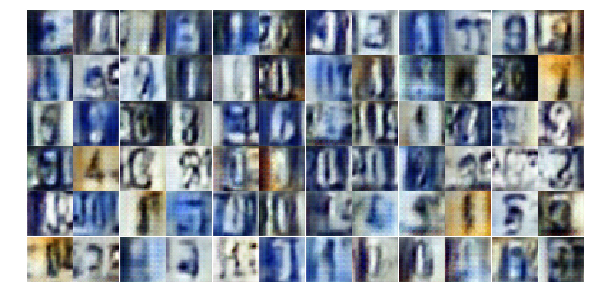

Epoch 12/25... Discriminator Loss: 1.3496... Generator Loss: 0.7201
Epoch 12/25... Discriminator Loss: 1.3229... Generator Loss: 0.7409
Epoch 12/25... Discriminator Loss: 1.3447... Generator Loss: 0.6945
Epoch 12/25... Discriminator Loss: 1.3787... Generator Loss: 0.7282
Epoch 12/25... Discriminator Loss: 1.3638... Generator Loss: 0.7046
Epoch 12/25... Discriminator Loss: 1.3360... Generator Loss: 0.7384
Epoch 12/25... Discriminator Loss: 1.3598... Generator Loss: 0.7058
Epoch 12/25... Discriminator Loss: 1.3526... Generator Loss: 0.6978
Epoch 12/25... Discriminator Loss: 1.3076... Generator Loss: 0.7877
Epoch 12/25... Discriminator Loss: 1.3907... Generator Loss: 0.6835


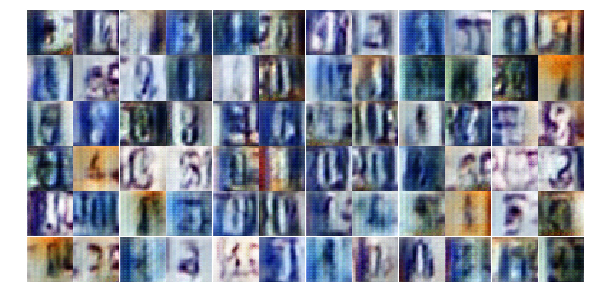

Epoch 12/25... Discriminator Loss: 1.3305... Generator Loss: 0.7167
Epoch 12/25... Discriminator Loss: 1.3690... Generator Loss: 0.6635
Epoch 12/25... Discriminator Loss: 1.4108... Generator Loss: 0.6277
Epoch 12/25... Discriminator Loss: 1.3686... Generator Loss: 0.6834
Epoch 12/25... Discriminator Loss: 1.3581... Generator Loss: 0.6710
Epoch 12/25... Discriminator Loss: 1.3381... Generator Loss: 0.7047
Epoch 12/25... Discriminator Loss: 1.3414... Generator Loss: 0.6565
Epoch 12/25... Discriminator Loss: 1.3570... Generator Loss: 0.7320
Epoch 12/25... Discriminator Loss: 1.3597... Generator Loss: 0.6923
Epoch 12/25... Discriminator Loss: 1.3457... Generator Loss: 0.8210


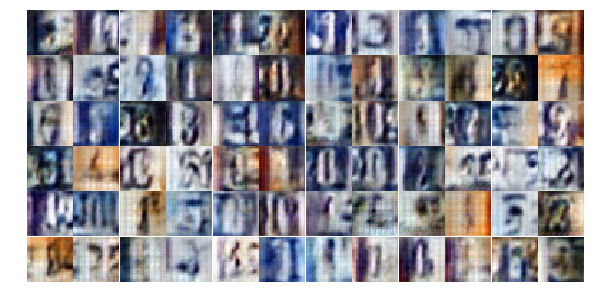

Epoch 12/25... Discriminator Loss: 1.3502... Generator Loss: 0.7088
Epoch 12/25... Discriminator Loss: 1.3838... Generator Loss: 0.7164
Epoch 12/25... Discriminator Loss: 1.3482... Generator Loss: 0.7440
Epoch 12/25... Discriminator Loss: 1.3598... Generator Loss: 0.6931
Epoch 12/25... Discriminator Loss: 1.3825... Generator Loss: 0.7143
Epoch 12/25... Discriminator Loss: 1.3799... Generator Loss: 0.7191
Epoch 12/25... Discriminator Loss: 1.3787... Generator Loss: 0.7190
Epoch 12/25... Discriminator Loss: 1.3932... Generator Loss: 0.7912
Epoch 12/25... Discriminator Loss: 1.3730... Generator Loss: 0.7369
Epoch 12/25... Discriminator Loss: 1.3169... Generator Loss: 0.6711


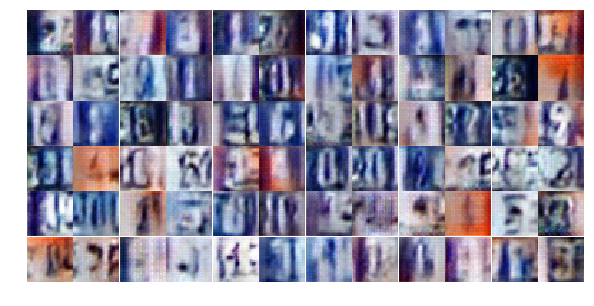

Epoch 12/25... Discriminator Loss: 1.3343... Generator Loss: 0.7864
Epoch 12/25... Discriminator Loss: 1.3207... Generator Loss: 0.7005
Epoch 12/25... Discriminator Loss: 1.3869... Generator Loss: 0.6070
Epoch 12/25... Discriminator Loss: 1.3469... Generator Loss: 0.7068
Epoch 12/25... Discriminator Loss: 1.3450... Generator Loss: 0.6825
Epoch 12/25... Discriminator Loss: 1.3838... Generator Loss: 0.6347
Epoch 12/25... Discriminator Loss: 1.3560... Generator Loss: 0.7493
Epoch 12/25... Discriminator Loss: 1.3768... Generator Loss: 0.6359
Epoch 12/25... Discriminator Loss: 1.3600... Generator Loss: 0.6475
Epoch 12/25... Discriminator Loss: 1.3580... Generator Loss: 0.7546


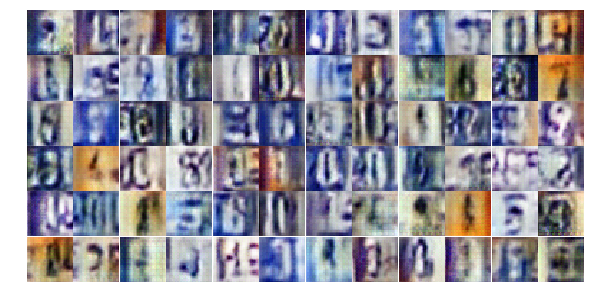

Epoch 12/25... Discriminator Loss: 1.3543... Generator Loss: 0.7225
Epoch 12/25... Discriminator Loss: 1.3362... Generator Loss: 0.6781
Epoch 12/25... Discriminator Loss: 1.2956... Generator Loss: 0.6796
Epoch 12/25... Discriminator Loss: 1.3946... Generator Loss: 0.7460
Epoch 12/25... Discriminator Loss: 1.4364... Generator Loss: 0.6479
Epoch 12/25... Discriminator Loss: 1.3746... Generator Loss: 0.6314
Epoch 12/25... Discriminator Loss: 1.3715... Generator Loss: 0.7617
Epoch 13/25... Discriminator Loss: 1.3038... Generator Loss: 0.6644
Epoch 13/25... Discriminator Loss: 1.3355... Generator Loss: 0.7568
Epoch 13/25... Discriminator Loss: 1.3756... Generator Loss: 0.6863


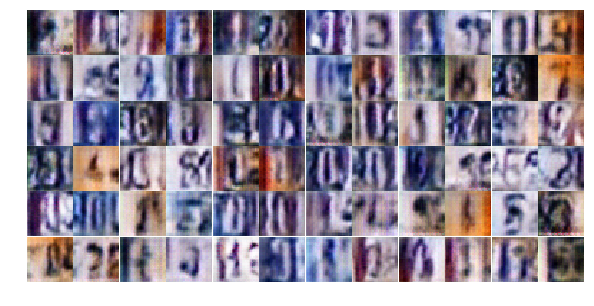

Epoch 13/25... Discriminator Loss: 1.3552... Generator Loss: 0.6571
Epoch 13/25... Discriminator Loss: 1.3758... Generator Loss: 0.7155
Epoch 13/25... Discriminator Loss: 1.3417... Generator Loss: 0.7203
Epoch 13/25... Discriminator Loss: 1.3814... Generator Loss: 0.7303
Epoch 13/25... Discriminator Loss: 1.3796... Generator Loss: 0.7006
Epoch 13/25... Discriminator Loss: 1.3637... Generator Loss: 0.7324
Epoch 13/25... Discriminator Loss: 1.3327... Generator Loss: 0.7201
Epoch 13/25... Discriminator Loss: 1.3934... Generator Loss: 0.6751
Epoch 13/25... Discriminator Loss: 1.3555... Generator Loss: 0.7325
Epoch 13/25... Discriminator Loss: 1.3549... Generator Loss: 0.7362


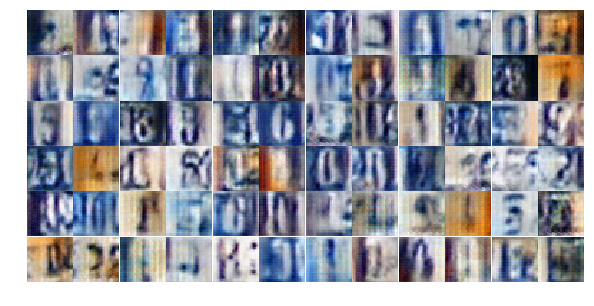

Epoch 13/25... Discriminator Loss: 1.3366... Generator Loss: 0.7075
Epoch 13/25... Discriminator Loss: 1.3256... Generator Loss: 0.8016
Epoch 13/25... Discriminator Loss: 1.3845... Generator Loss: 0.6421
Epoch 13/25... Discriminator Loss: 1.3859... Generator Loss: 0.7538
Epoch 13/25... Discriminator Loss: 1.3539... Generator Loss: 0.7187
Epoch 13/25... Discriminator Loss: 1.3695... Generator Loss: 0.7520
Epoch 13/25... Discriminator Loss: 1.3671... Generator Loss: 0.6936
Epoch 13/25... Discriminator Loss: 1.3750... Generator Loss: 0.6787
Epoch 13/25... Discriminator Loss: 1.3364... Generator Loss: 0.7065
Epoch 13/25... Discriminator Loss: 1.3597... Generator Loss: 0.7514


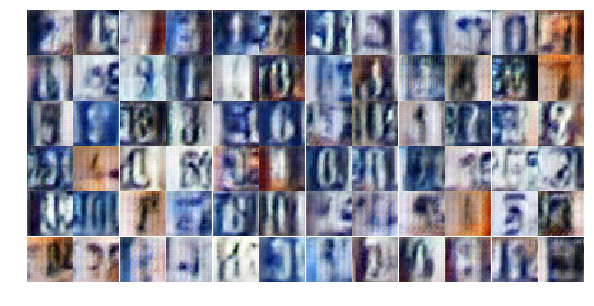

Epoch 13/25... Discriminator Loss: 1.3608... Generator Loss: 0.7008
Epoch 13/25... Discriminator Loss: 1.3619... Generator Loss: 0.7364
Epoch 13/25... Discriminator Loss: 1.3745... Generator Loss: 0.7041
Epoch 13/25... Discriminator Loss: 1.3756... Generator Loss: 0.6642
Epoch 13/25... Discriminator Loss: 1.3515... Generator Loss: 0.6717
Epoch 13/25... Discriminator Loss: 1.3608... Generator Loss: 0.7268
Epoch 13/25... Discriminator Loss: 1.3384... Generator Loss: 0.6217
Epoch 13/25... Discriminator Loss: 1.3791... Generator Loss: 0.7395
Epoch 13/25... Discriminator Loss: 1.3405... Generator Loss: 0.7214
Epoch 13/25... Discriminator Loss: 1.3995... Generator Loss: 0.6261


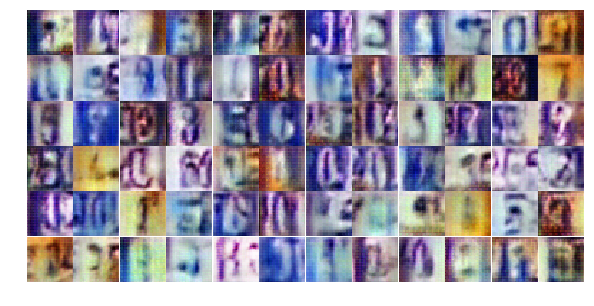

Epoch 13/25... Discriminator Loss: 1.3568... Generator Loss: 0.7403
Epoch 13/25... Discriminator Loss: 1.3502... Generator Loss: 0.7419
Epoch 13/25... Discriminator Loss: 1.4125... Generator Loss: 0.6741
Epoch 13/25... Discriminator Loss: 1.3305... Generator Loss: 0.7216
Epoch 13/25... Discriminator Loss: 1.3648... Generator Loss: 0.7092
Epoch 13/25... Discriminator Loss: 1.3671... Generator Loss: 0.6759
Epoch 13/25... Discriminator Loss: 1.3538... Generator Loss: 0.7759
Epoch 13/25... Discriminator Loss: 1.3803... Generator Loss: 0.7007
Epoch 13/25... Discriminator Loss: 1.3628... Generator Loss: 0.7092
Epoch 13/25... Discriminator Loss: 1.3421... Generator Loss: 0.6984


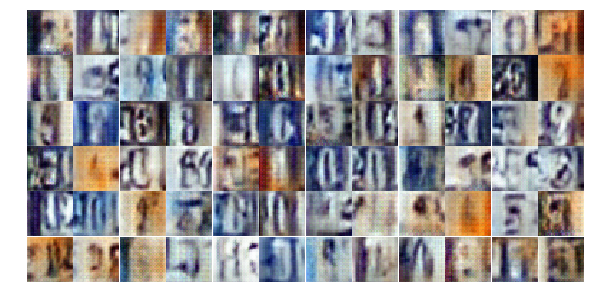

Epoch 13/25... Discriminator Loss: 1.3457... Generator Loss: 0.7151
Epoch 13/25... Discriminator Loss: 1.3783... Generator Loss: 0.6303
Epoch 13/25... Discriminator Loss: 1.3947... Generator Loss: 0.7451
Epoch 13/25... Discriminator Loss: 1.3770... Generator Loss: 0.7012
Epoch 13/25... Discriminator Loss: 1.4021... Generator Loss: 0.6854
Epoch 13/25... Discriminator Loss: 1.3848... Generator Loss: 0.7167
Epoch 13/25... Discriminator Loss: 1.3913... Generator Loss: 0.7024
Epoch 13/25... Discriminator Loss: 1.3440... Generator Loss: 0.7108
Epoch 13/25... Discriminator Loss: 1.3842... Generator Loss: 0.6877
Epoch 13/25... Discriminator Loss: 1.3468... Generator Loss: 0.6802


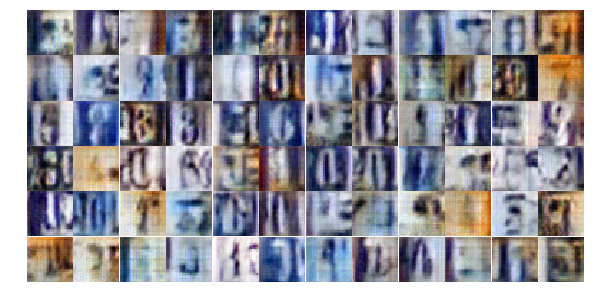

Epoch 13/25... Discriminator Loss: 1.3540... Generator Loss: 0.7237
Epoch 13/25... Discriminator Loss: 1.3827... Generator Loss: 0.6765
Epoch 13/25... Discriminator Loss: 1.3573... Generator Loss: 0.6986
Epoch 13/25... Discriminator Loss: 1.3812... Generator Loss: 0.6789
Epoch 14/25... Discriminator Loss: 1.3862... Generator Loss: 0.6917
Epoch 14/25... Discriminator Loss: 1.3782... Generator Loss: 0.6817
Epoch 14/25... Discriminator Loss: 1.3737... Generator Loss: 0.6989
Epoch 14/25... Discriminator Loss: 1.3514... Generator Loss: 0.7227
Epoch 14/25... Discriminator Loss: 1.3787... Generator Loss: 0.6975
Epoch 14/25... Discriminator Loss: 1.3973... Generator Loss: 0.6669


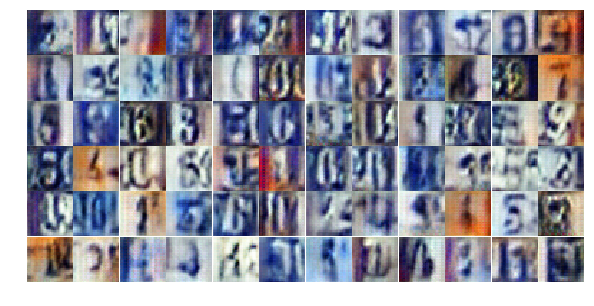

Epoch 14/25... Discriminator Loss: 1.3763... Generator Loss: 0.6974
Epoch 14/25... Discriminator Loss: 1.3764... Generator Loss: 0.7455
Epoch 14/25... Discriminator Loss: 1.3721... Generator Loss: 0.7613
Epoch 14/25... Discriminator Loss: 1.3910... Generator Loss: 0.7123
Epoch 14/25... Discriminator Loss: 1.3867... Generator Loss: 0.7470
Epoch 14/25... Discriminator Loss: 1.3514... Generator Loss: 0.6516
Epoch 14/25... Discriminator Loss: 1.3463... Generator Loss: 0.6781
Epoch 14/25... Discriminator Loss: 1.3915... Generator Loss: 0.7079
Epoch 14/25... Discriminator Loss: 1.4021... Generator Loss: 0.6901
Epoch 14/25... Discriminator Loss: 1.3909... Generator Loss: 0.6753


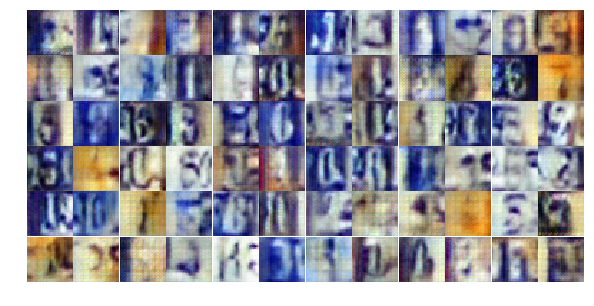

Epoch 14/25... Discriminator Loss: 1.3640... Generator Loss: 0.6768
Epoch 14/25... Discriminator Loss: 1.3519... Generator Loss: 0.7392
Epoch 14/25... Discriminator Loss: 1.3851... Generator Loss: 0.6897
Epoch 14/25... Discriminator Loss: 1.3620... Generator Loss: 0.6984
Epoch 14/25... Discriminator Loss: 1.3431... Generator Loss: 0.7399
Epoch 14/25... Discriminator Loss: 1.3608... Generator Loss: 0.6734
Epoch 14/25... Discriminator Loss: 1.4016... Generator Loss: 0.7041
Epoch 14/25... Discriminator Loss: 1.3752... Generator Loss: 0.7222
Epoch 14/25... Discriminator Loss: 1.3567... Generator Loss: 0.7121
Epoch 14/25... Discriminator Loss: 1.3910... Generator Loss: 0.7057


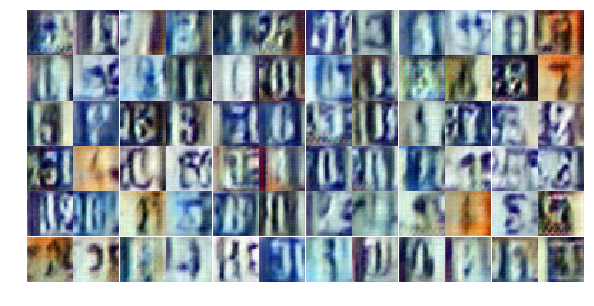

Epoch 14/25... Discriminator Loss: 1.3409... Generator Loss: 0.7405
Epoch 14/25... Discriminator Loss: 1.3705... Generator Loss: 0.7840
Epoch 14/25... Discriminator Loss: 1.3577... Generator Loss: 0.7181
Epoch 14/25... Discriminator Loss: 1.3508... Generator Loss: 0.7219
Epoch 14/25... Discriminator Loss: 1.3473... Generator Loss: 0.7089
Epoch 14/25... Discriminator Loss: 1.3968... Generator Loss: 0.7085
Epoch 14/25... Discriminator Loss: 1.3544... Generator Loss: 0.6988
Epoch 14/25... Discriminator Loss: 1.4063... Generator Loss: 0.7085
Epoch 14/25... Discriminator Loss: 1.3991... Generator Loss: 0.6429
Epoch 14/25... Discriminator Loss: 1.4105... Generator Loss: 0.7656


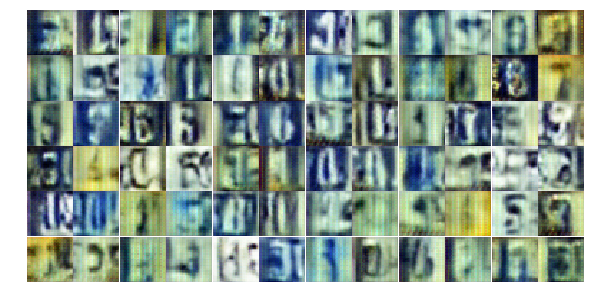

Epoch 14/25... Discriminator Loss: 1.4199... Generator Loss: 0.7091
Epoch 14/25... Discriminator Loss: 1.3387... Generator Loss: 0.7560
Epoch 14/25... Discriminator Loss: 1.4325... Generator Loss: 0.8391
Epoch 14/25... Discriminator Loss: 1.4096... Generator Loss: 0.7096
Epoch 14/25... Discriminator Loss: 1.3479... Generator Loss: 0.7296
Epoch 14/25... Discriminator Loss: 1.3743... Generator Loss: 0.6813
Epoch 14/25... Discriminator Loss: 1.3867... Generator Loss: 0.6978
Epoch 14/25... Discriminator Loss: 1.3845... Generator Loss: 0.6738
Epoch 14/25... Discriminator Loss: 1.3767... Generator Loss: 0.7192
Epoch 14/25... Discriminator Loss: 1.3974... Generator Loss: 0.7079


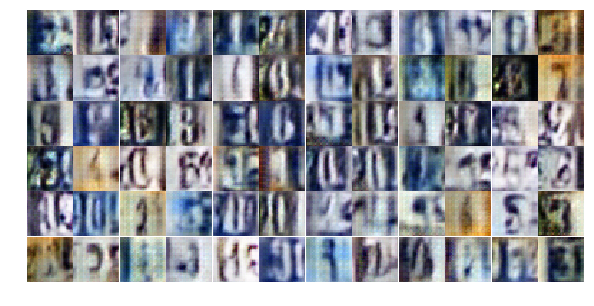

Epoch 14/25... Discriminator Loss: 1.3756... Generator Loss: 0.7005
Epoch 14/25... Discriminator Loss: 1.3701... Generator Loss: 0.7283
Epoch 14/25... Discriminator Loss: 1.3668... Generator Loss: 0.6979
Epoch 14/25... Discriminator Loss: 1.3786... Generator Loss: 0.6831
Epoch 14/25... Discriminator Loss: 1.3621... Generator Loss: 0.6698
Epoch 14/25... Discriminator Loss: 1.3622... Generator Loss: 0.7134
Epoch 14/25... Discriminator Loss: 1.3555... Generator Loss: 0.7068
Epoch 14/25... Discriminator Loss: 1.3509... Generator Loss: 0.6957
Epoch 14/25... Discriminator Loss: 1.3800... Generator Loss: 0.7641
Epoch 14/25... Discriminator Loss: 1.3769... Generator Loss: 0.6885


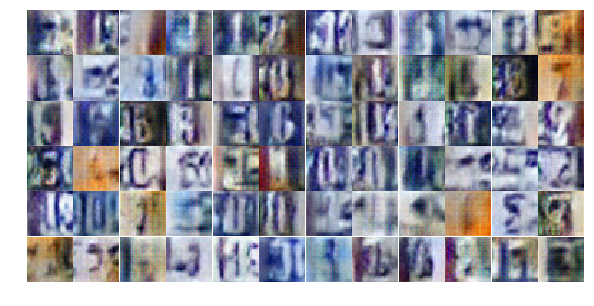

Epoch 14/25... Discriminator Loss: 1.3686... Generator Loss: 0.7396
Epoch 14/25... Discriminator Loss: 1.3644... Generator Loss: 0.7223
Epoch 15/25... Discriminator Loss: 1.3617... Generator Loss: 0.7316
Epoch 15/25... Discriminator Loss: 1.3785... Generator Loss: 0.6799
Epoch 15/25... Discriminator Loss: 1.3624... Generator Loss: 0.6772
Epoch 15/25... Discriminator Loss: 1.3794... Generator Loss: 0.7145
Epoch 15/25... Discriminator Loss: 1.3576... Generator Loss: 0.7300
Epoch 15/25... Discriminator Loss: 1.3740... Generator Loss: 0.7246
Epoch 15/25... Discriminator Loss: 1.3852... Generator Loss: 0.6982
Epoch 15/25... Discriminator Loss: 1.3739... Generator Loss: 0.6999


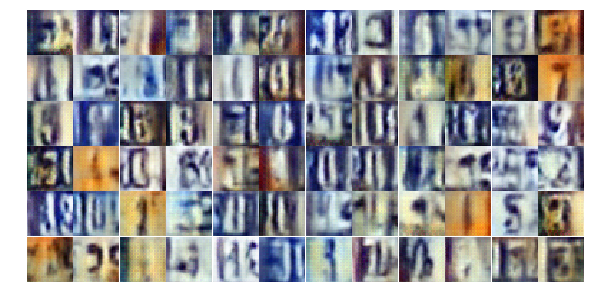

Epoch 15/25... Discriminator Loss: 1.3592... Generator Loss: 0.6732
Epoch 15/25... Discriminator Loss: 1.4020... Generator Loss: 0.6928
Epoch 15/25... Discriminator Loss: 1.4020... Generator Loss: 0.7769
Epoch 15/25... Discriminator Loss: 1.3776... Generator Loss: 0.6968
Epoch 15/25... Discriminator Loss: 1.3853... Generator Loss: 0.7168
Epoch 15/25... Discriminator Loss: 1.3406... Generator Loss: 0.7312
Epoch 15/25... Discriminator Loss: 1.3786... Generator Loss: 0.6831
Epoch 15/25... Discriminator Loss: 1.3856... Generator Loss: 0.7171
Epoch 15/25... Discriminator Loss: 1.3756... Generator Loss: 0.6635
Epoch 15/25... Discriminator Loss: 1.3689... Generator Loss: 0.6899


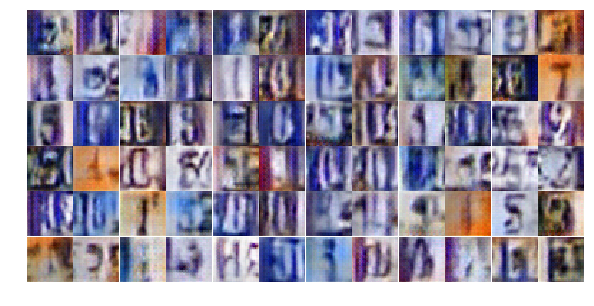

Epoch 15/25... Discriminator Loss: 1.3621... Generator Loss: 0.7427
Epoch 15/25... Discriminator Loss: 1.3809... Generator Loss: 0.7222
Epoch 15/25... Discriminator Loss: 1.3913... Generator Loss: 0.7141
Epoch 15/25... Discriminator Loss: 1.3791... Generator Loss: 0.6852
Epoch 15/25... Discriminator Loss: 1.3752... Generator Loss: 0.6904
Epoch 15/25... Discriminator Loss: 1.3737... Generator Loss: 0.6826
Epoch 15/25... Discriminator Loss: 1.3787... Generator Loss: 0.7021
Epoch 15/25... Discriminator Loss: 1.3534... Generator Loss: 0.7477
Epoch 15/25... Discriminator Loss: 1.3481... Generator Loss: 0.6705
Epoch 15/25... Discriminator Loss: 1.3557... Generator Loss: 0.7163


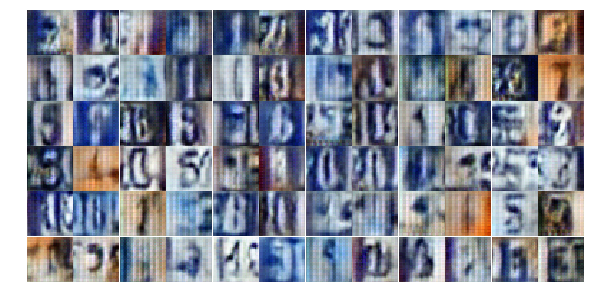

Epoch 15/25... Discriminator Loss: 1.3927... Generator Loss: 0.7006
Epoch 15/25... Discriminator Loss: 1.3635... Generator Loss: 0.7055
Epoch 15/25... Discriminator Loss: 1.3865... Generator Loss: 0.6929
Epoch 15/25... Discriminator Loss: 1.3695... Generator Loss: 0.7106
Epoch 15/25... Discriminator Loss: 1.3724... Generator Loss: 0.7032
Epoch 15/25... Discriminator Loss: 1.4222... Generator Loss: 0.6432
Epoch 15/25... Discriminator Loss: 1.3951... Generator Loss: 0.6938
Epoch 15/25... Discriminator Loss: 1.4120... Generator Loss: 0.6871
Epoch 15/25... Discriminator Loss: 1.3813... Generator Loss: 0.6868
Epoch 15/25... Discriminator Loss: 1.3777... Generator Loss: 0.7293


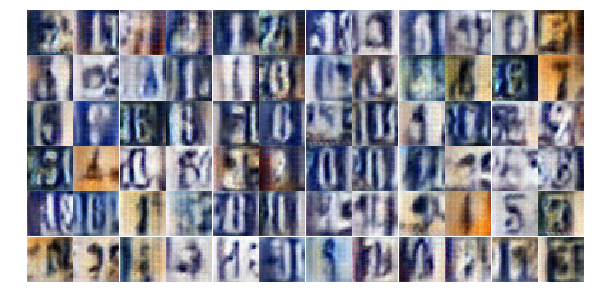

Epoch 15/25... Discriminator Loss: 1.3649... Generator Loss: 0.7134
Epoch 15/25... Discriminator Loss: 1.3539... Generator Loss: 0.7038
Epoch 15/25... Discriminator Loss: 1.3848... Generator Loss: 0.7285
Epoch 15/25... Discriminator Loss: 1.4167... Generator Loss: 0.7137
Epoch 15/25... Discriminator Loss: 1.3771... Generator Loss: 0.7010
Epoch 15/25... Discriminator Loss: 1.3789... Generator Loss: 0.6596
Epoch 15/25... Discriminator Loss: 1.3605... Generator Loss: 0.6661
Epoch 15/25... Discriminator Loss: 1.3892... Generator Loss: 0.6731
Epoch 15/25... Discriminator Loss: 1.3495... Generator Loss: 0.7165
Epoch 15/25... Discriminator Loss: 1.3514... Generator Loss: 0.6774


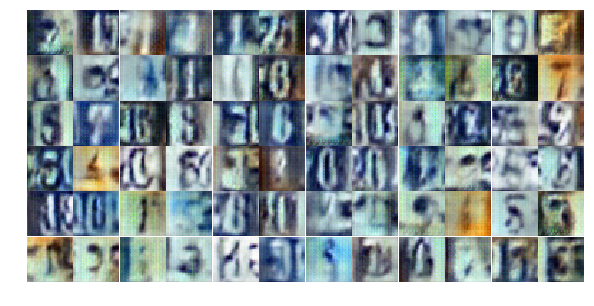

Epoch 15/25... Discriminator Loss: 1.3839... Generator Loss: 0.6679
Epoch 15/25... Discriminator Loss: 1.3964... Generator Loss: 0.6875
Epoch 15/25... Discriminator Loss: 1.3746... Generator Loss: 0.7093
Epoch 15/25... Discriminator Loss: 1.3601... Generator Loss: 0.6816
Epoch 15/25... Discriminator Loss: 1.3720... Generator Loss: 0.7187
Epoch 15/25... Discriminator Loss: 1.3718... Generator Loss: 0.6916
Epoch 15/25... Discriminator Loss: 1.3653... Generator Loss: 0.7020
Epoch 15/25... Discriminator Loss: 1.3654... Generator Loss: 0.6366
Epoch 15/25... Discriminator Loss: 1.3938... Generator Loss: 0.7050
Epoch 16/25... Discriminator Loss: 1.4118... Generator Loss: 0.6732


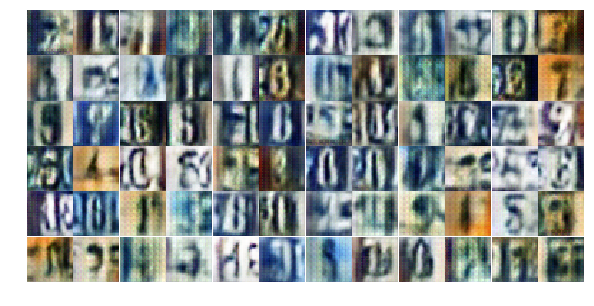

Epoch 16/25... Discriminator Loss: 1.3597... Generator Loss: 0.6898
Epoch 16/25... Discriminator Loss: 1.3797... Generator Loss: 0.7466
Epoch 16/25... Discriminator Loss: 1.4122... Generator Loss: 0.7519
Epoch 16/25... Discriminator Loss: 1.3955... Generator Loss: 0.7128
Epoch 16/25... Discriminator Loss: 1.3716... Generator Loss: 0.7021
Epoch 16/25... Discriminator Loss: 1.3806... Generator Loss: 0.6944
Epoch 16/25... Discriminator Loss: 1.3774... Generator Loss: 0.7199
Epoch 16/25... Discriminator Loss: 1.3870... Generator Loss: 0.7221
Epoch 16/25... Discriminator Loss: 1.3659... Generator Loss: 0.7111
Epoch 16/25... Discriminator Loss: 1.3707... Generator Loss: 0.7100


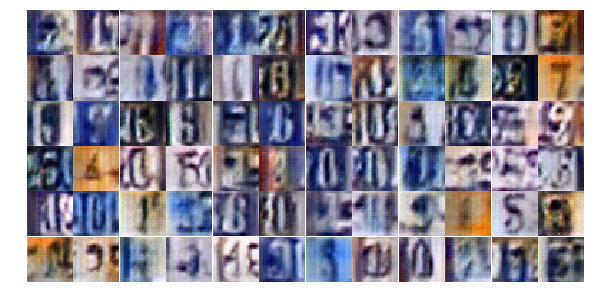

Epoch 16/25... Discriminator Loss: 1.3828... Generator Loss: 0.7341
Epoch 16/25... Discriminator Loss: 1.3488... Generator Loss: 0.7131
Epoch 16/25... Discriminator Loss: 1.3644... Generator Loss: 0.7208
Epoch 16/25... Discriminator Loss: 1.3801... Generator Loss: 0.7409
Epoch 16/25... Discriminator Loss: 1.3808... Generator Loss: 0.6715
Epoch 16/25... Discriminator Loss: 1.3813... Generator Loss: 0.7270
Epoch 16/25... Discriminator Loss: 1.3649... Generator Loss: 0.7078
Epoch 16/25... Discriminator Loss: 1.3748... Generator Loss: 0.6715
Epoch 16/25... Discriminator Loss: 1.3563... Generator Loss: 0.7359
Epoch 16/25... Discriminator Loss: 1.3445... Generator Loss: 0.7224


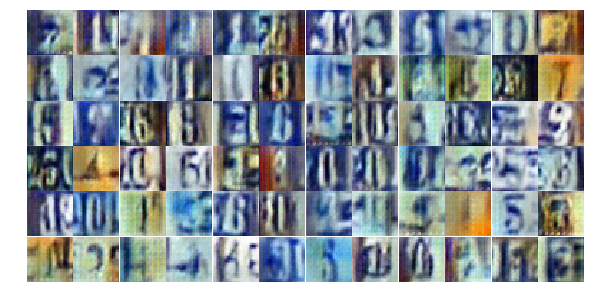

Epoch 16/25... Discriminator Loss: 1.3600... Generator Loss: 0.7368
Epoch 16/25... Discriminator Loss: 1.3497... Generator Loss: 0.7266
Epoch 16/25... Discriminator Loss: 1.3357... Generator Loss: 0.7162
Epoch 16/25... Discriminator Loss: 1.3586... Generator Loss: 0.7019
Epoch 16/25... Discriminator Loss: 1.4189... Generator Loss: 0.7183
Epoch 16/25... Discriminator Loss: 1.3800... Generator Loss: 0.7274
Epoch 16/25... Discriminator Loss: 1.3675... Generator Loss: 0.6806
Epoch 16/25... Discriminator Loss: 1.3496... Generator Loss: 0.7295
Epoch 16/25... Discriminator Loss: 1.3631... Generator Loss: 0.6751
Epoch 16/25... Discriminator Loss: 1.3965... Generator Loss: 0.7387


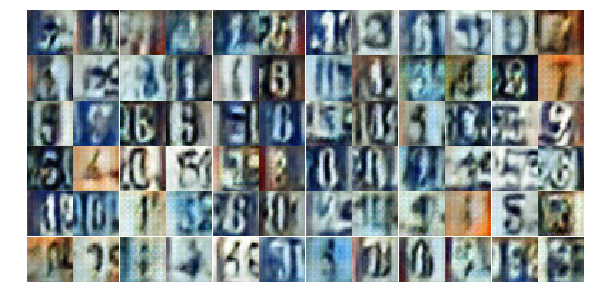

Epoch 16/25... Discriminator Loss: 1.3885... Generator Loss: 0.7126
Epoch 16/25... Discriminator Loss: 1.3992... Generator Loss: 0.6835
Epoch 16/25... Discriminator Loss: 1.3523... Generator Loss: 0.7194
Epoch 16/25... Discriminator Loss: 1.3672... Generator Loss: 0.7286
Epoch 16/25... Discriminator Loss: 1.3727... Generator Loss: 0.7027
Epoch 16/25... Discriminator Loss: 1.3746... Generator Loss: 0.7075
Epoch 16/25... Discriminator Loss: 1.3936... Generator Loss: 0.7125
Epoch 16/25... Discriminator Loss: 1.4014... Generator Loss: 0.6810
Epoch 16/25... Discriminator Loss: 1.3713... Generator Loss: 0.7250
Epoch 16/25... Discriminator Loss: 1.3686... Generator Loss: 0.6785


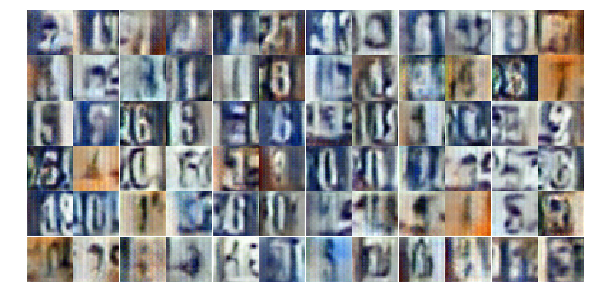

Epoch 16/25... Discriminator Loss: 1.3625... Generator Loss: 0.6949
Epoch 16/25... Discriminator Loss: 1.3829... Generator Loss: 0.7215
Epoch 16/25... Discriminator Loss: 1.4045... Generator Loss: 0.6921
Epoch 16/25... Discriminator Loss: 1.3671... Generator Loss: 0.7042
Epoch 16/25... Discriminator Loss: 1.3849... Generator Loss: 0.7369
Epoch 16/25... Discriminator Loss: 1.3748... Generator Loss: 0.6889
Epoch 16/25... Discriminator Loss: 1.3702... Generator Loss: 0.7249
Epoch 16/25... Discriminator Loss: 1.3887... Generator Loss: 0.7118
Epoch 16/25... Discriminator Loss: 1.3783... Generator Loss: 0.7026
Epoch 16/25... Discriminator Loss: 1.3684... Generator Loss: 0.7107


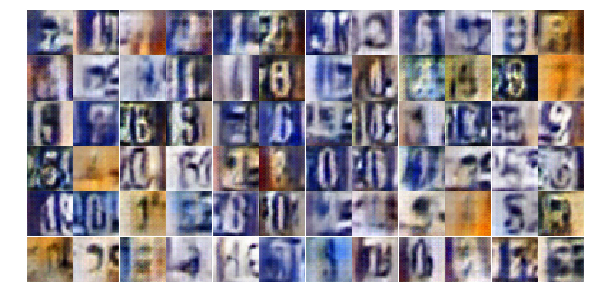

Epoch 16/25... Discriminator Loss: 1.3935... Generator Loss: 0.7039
Epoch 16/25... Discriminator Loss: 1.3751... Generator Loss: 0.6794
Epoch 16/25... Discriminator Loss: 1.3867... Generator Loss: 0.6989
Epoch 16/25... Discriminator Loss: 1.3807... Generator Loss: 0.7180
Epoch 16/25... Discriminator Loss: 1.3853... Generator Loss: 0.7041
Epoch 16/25... Discriminator Loss: 1.3771... Generator Loss: 0.6855
Epoch 17/25... Discriminator Loss: 1.3909... Generator Loss: 0.7087
Epoch 17/25... Discriminator Loss: 1.3915... Generator Loss: 0.6924
Epoch 17/25... Discriminator Loss: 1.3855... Generator Loss: 0.6975
Epoch 17/25... Discriminator Loss: 1.3795... Generator Loss: 0.6891


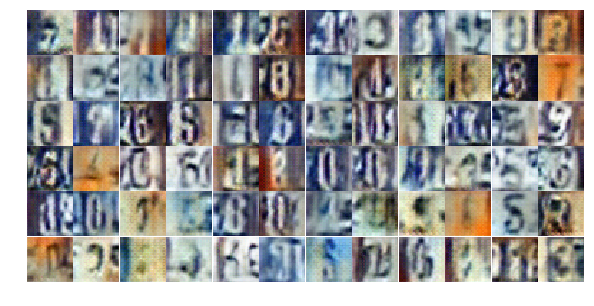

Epoch 17/25... Discriminator Loss: 1.3883... Generator Loss: 0.6715
Epoch 17/25... Discriminator Loss: 1.3420... Generator Loss: 0.7173
Epoch 17/25... Discriminator Loss: 1.3500... Generator Loss: 0.6942
Epoch 17/25... Discriminator Loss: 1.3595... Generator Loss: 0.7057
Epoch 17/25... Discriminator Loss: 1.3585... Generator Loss: 0.7343
Epoch 17/25... Discriminator Loss: 1.3508... Generator Loss: 0.6872
Epoch 17/25... Discriminator Loss: 1.4060... Generator Loss: 0.7369
Epoch 17/25... Discriminator Loss: 1.3913... Generator Loss: 0.6568
Epoch 17/25... Discriminator Loss: 1.3651... Generator Loss: 0.6709
Epoch 17/25... Discriminator Loss: 1.4149... Generator Loss: 0.6914


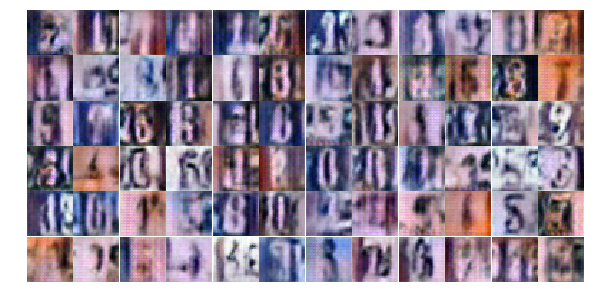

Epoch 17/25... Discriminator Loss: 1.3752... Generator Loss: 0.7054
Epoch 17/25... Discriminator Loss: 1.3962... Generator Loss: 0.7214
Epoch 17/25... Discriminator Loss: 1.3533... Generator Loss: 0.6903
Epoch 17/25... Discriminator Loss: 1.4137... Generator Loss: 0.6727
Epoch 17/25... Discriminator Loss: 1.3739... Generator Loss: 0.7306
Epoch 17/25... Discriminator Loss: 1.3579... Generator Loss: 0.7118
Epoch 17/25... Discriminator Loss: 1.3834... Generator Loss: 0.6911
Epoch 17/25... Discriminator Loss: 1.3618... Generator Loss: 0.6745
Epoch 17/25... Discriminator Loss: 1.3624... Generator Loss: 0.7105
Epoch 17/25... Discriminator Loss: 1.4017... Generator Loss: 0.7019


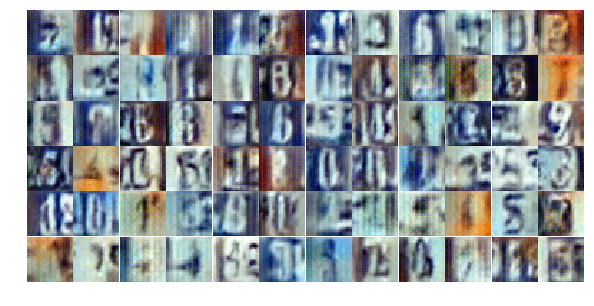

Epoch 17/25... Discriminator Loss: 1.3943... Generator Loss: 0.7080
Epoch 17/25... Discriminator Loss: 1.3871... Generator Loss: 0.6872
Epoch 17/25... Discriminator Loss: 1.3877... Generator Loss: 0.6904
Epoch 17/25... Discriminator Loss: 1.3825... Generator Loss: 0.6970
Epoch 17/25... Discriminator Loss: 1.4028... Generator Loss: 0.6766
Epoch 17/25... Discriminator Loss: 1.3669... Generator Loss: 0.7129
Epoch 17/25... Discriminator Loss: 1.3709... Generator Loss: 0.6870
Epoch 17/25... Discriminator Loss: 1.3908... Generator Loss: 0.6969
Epoch 17/25... Discriminator Loss: 1.3622... Generator Loss: 0.7051
Epoch 17/25... Discriminator Loss: 1.3939... Generator Loss: 0.6797


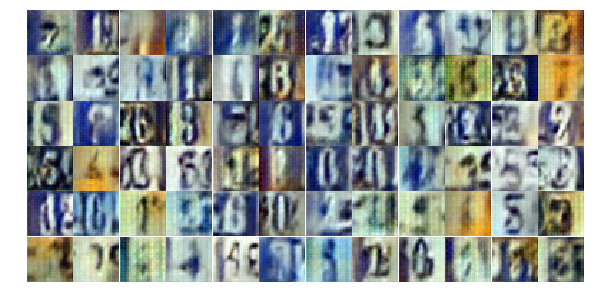

Epoch 17/25... Discriminator Loss: 1.3850... Generator Loss: 0.6483
Epoch 17/25... Discriminator Loss: 1.4162... Generator Loss: 0.6742
Epoch 17/25... Discriminator Loss: 1.3527... Generator Loss: 0.6955
Epoch 17/25... Discriminator Loss: 1.3906... Generator Loss: 0.7231
Epoch 17/25... Discriminator Loss: 1.3596... Generator Loss: 0.6882
Epoch 17/25... Discriminator Loss: 1.3833... Generator Loss: 0.7069
Epoch 17/25... Discriminator Loss: 1.3935... Generator Loss: 0.6937
Epoch 17/25... Discriminator Loss: 1.3692... Generator Loss: 0.6788
Epoch 17/25... Discriminator Loss: 1.3703... Generator Loss: 0.7140
Epoch 17/25... Discriminator Loss: 1.3966... Generator Loss: 0.6903


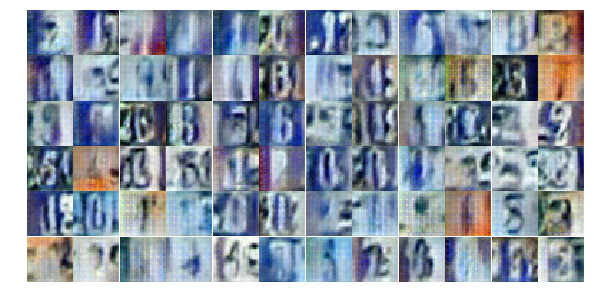

Epoch 17/25... Discriminator Loss: 1.3709... Generator Loss: 0.7321
Epoch 17/25... Discriminator Loss: 1.3748... Generator Loss: 0.6880
Epoch 17/25... Discriminator Loss: 1.3883... Generator Loss: 0.6734
Epoch 17/25... Discriminator Loss: 1.3640... Generator Loss: 0.7137
Epoch 17/25... Discriminator Loss: 1.3778... Generator Loss: 0.6444
Epoch 17/25... Discriminator Loss: 1.3701... Generator Loss: 0.6803
Epoch 17/25... Discriminator Loss: 1.3842... Generator Loss: 0.6572
Epoch 17/25... Discriminator Loss: 1.3970... Generator Loss: 0.7067
Epoch 17/25... Discriminator Loss: 1.4052... Generator Loss: 0.7037
Epoch 17/25... Discriminator Loss: 1.4238... Generator Loss: 0.6669


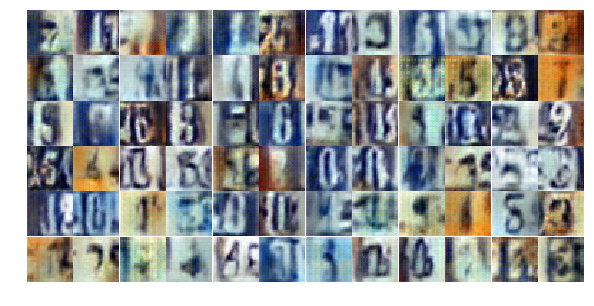

Epoch 17/25... Discriminator Loss: 1.3783... Generator Loss: 0.6511
Epoch 17/25... Discriminator Loss: 1.3793... Generator Loss: 0.7060
Epoch 17/25... Discriminator Loss: 1.3720... Generator Loss: 0.7280
Epoch 17/25... Discriminator Loss: 1.3838... Generator Loss: 0.7194
Epoch 18/25... Discriminator Loss: 1.4051... Generator Loss: 0.6953
Epoch 18/25... Discriminator Loss: 1.3763... Generator Loss: 0.6967
Epoch 18/25... Discriminator Loss: 1.3772... Generator Loss: 0.6876
Epoch 18/25... Discriminator Loss: 1.3808... Generator Loss: 0.6960
Epoch 18/25... Discriminator Loss: 1.3909... Generator Loss: 0.6762
Epoch 18/25... Discriminator Loss: 1.3826... Generator Loss: 0.7046


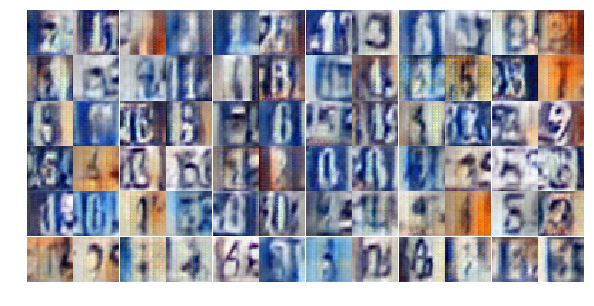

Epoch 18/25... Discriminator Loss: 1.3608... Generator Loss: 0.6952
Epoch 18/25... Discriminator Loss: 1.3822... Generator Loss: 0.6950
Epoch 18/25... Discriminator Loss: 1.3837... Generator Loss: 0.6818
Epoch 18/25... Discriminator Loss: 1.3707... Generator Loss: 0.6940
Epoch 18/25... Discriminator Loss: 1.3800... Generator Loss: 0.7369
Epoch 18/25... Discriminator Loss: 1.3683... Generator Loss: 0.6947
Epoch 18/25... Discriminator Loss: 1.3929... Generator Loss: 0.7108
Epoch 18/25... Discriminator Loss: 1.3779... Generator Loss: 0.7002
Epoch 18/25... Discriminator Loss: 1.3572... Generator Loss: 0.6947
Epoch 18/25... Discriminator Loss: 1.3687... Generator Loss: 0.7265


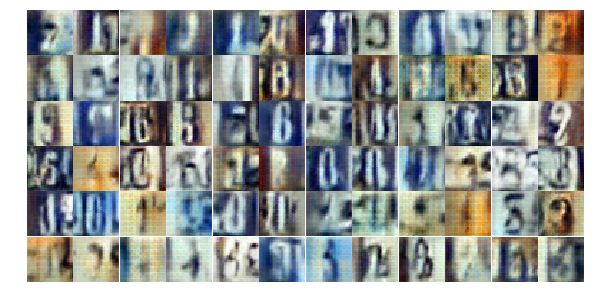

Epoch 18/25... Discriminator Loss: 1.3712... Generator Loss: 0.6444
Epoch 18/25... Discriminator Loss: 1.3578... Generator Loss: 0.6873
Epoch 18/25... Discriminator Loss: 1.4027... Generator Loss: 0.6919
Epoch 18/25... Discriminator Loss: 1.4077... Generator Loss: 0.6993
Epoch 18/25... Discriminator Loss: 1.3570... Generator Loss: 0.7163
Epoch 18/25... Discriminator Loss: 1.3707... Generator Loss: 0.6890
Epoch 18/25... Discriminator Loss: 1.3895... Generator Loss: 0.6954
Epoch 18/25... Discriminator Loss: 1.3640... Generator Loss: 0.6793
Epoch 18/25... Discriminator Loss: 1.3757... Generator Loss: 0.7016
Epoch 18/25... Discriminator Loss: 1.3764... Generator Loss: 0.7232


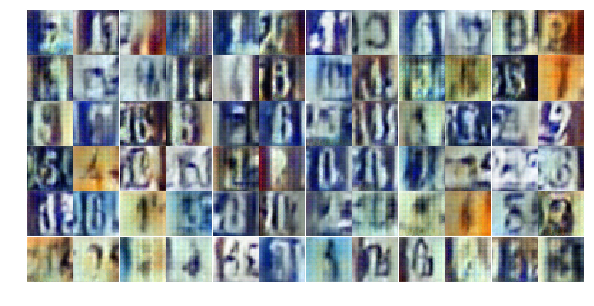

Epoch 18/25... Discriminator Loss: 1.3804... Generator Loss: 0.6904
Epoch 18/25... Discriminator Loss: 1.3739... Generator Loss: 0.7008
Epoch 18/25... Discriminator Loss: 1.3644... Generator Loss: 0.6802
Epoch 18/25... Discriminator Loss: 1.4011... Generator Loss: 0.6708
Epoch 18/25... Discriminator Loss: 1.3706... Generator Loss: 0.6993
Epoch 18/25... Discriminator Loss: 1.3749... Generator Loss: 0.7038
Epoch 18/25... Discriminator Loss: 1.3879... Generator Loss: 0.6874
Epoch 18/25... Discriminator Loss: 1.3776... Generator Loss: 0.6973
Epoch 18/25... Discriminator Loss: 1.3885... Generator Loss: 0.7034
Epoch 18/25... Discriminator Loss: 1.4130... Generator Loss: 0.6949


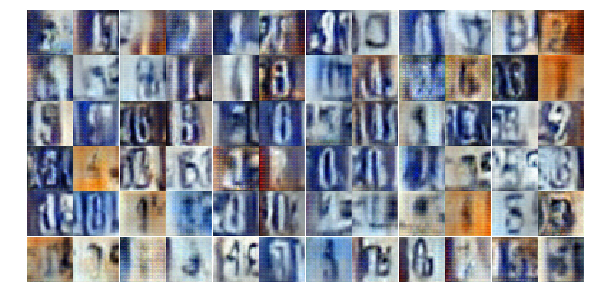

Epoch 18/25... Discriminator Loss: 1.3401... Generator Loss: 0.6932
Epoch 18/25... Discriminator Loss: 1.3716... Generator Loss: 0.7245
Epoch 18/25... Discriminator Loss: 1.3993... Generator Loss: 0.6896
Epoch 18/25... Discriminator Loss: 1.3913... Generator Loss: 0.7025
Epoch 18/25... Discriminator Loss: 1.4157... Generator Loss: 0.7135
Epoch 18/25... Discriminator Loss: 1.3785... Generator Loss: 0.6923
Epoch 18/25... Discriminator Loss: 1.3896... Generator Loss: 0.7040
Epoch 18/25... Discriminator Loss: 1.3925... Generator Loss: 0.6868
Epoch 18/25... Discriminator Loss: 1.3699... Generator Loss: 0.7138
Epoch 18/25... Discriminator Loss: 1.3700... Generator Loss: 0.7187


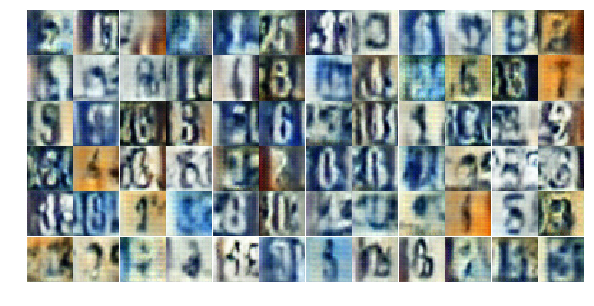

Epoch 18/25... Discriminator Loss: 1.3837... Generator Loss: 0.6802
Epoch 18/25... Discriminator Loss: 1.3793... Generator Loss: 0.6935
Epoch 18/25... Discriminator Loss: 1.3764... Generator Loss: 0.6933
Epoch 18/25... Discriminator Loss: 1.3763... Generator Loss: 0.6964
Epoch 18/25... Discriminator Loss: 1.3870... Generator Loss: 0.7073
Epoch 18/25... Discriminator Loss: 1.4243... Generator Loss: 0.7053
Epoch 18/25... Discriminator Loss: 1.3882... Generator Loss: 0.7012
Epoch 18/25... Discriminator Loss: 1.3532... Generator Loss: 0.7252
Epoch 18/25... Discriminator Loss: 1.3612... Generator Loss: 0.6927
Epoch 18/25... Discriminator Loss: 1.4203... Generator Loss: 0.7387


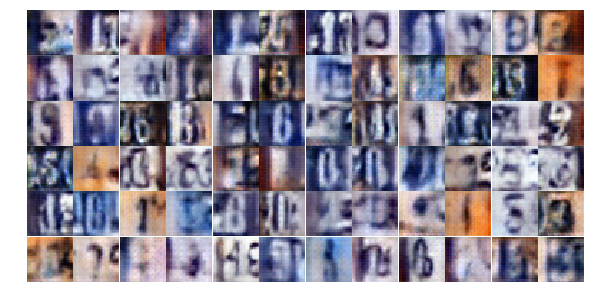

Epoch 18/25... Discriminator Loss: 1.3773... Generator Loss: 0.7062
Epoch 19/25... Discriminator Loss: 1.3882... Generator Loss: 0.7025
Epoch 19/25... Discriminator Loss: 1.3923... Generator Loss: 0.6938
Epoch 19/25... Discriminator Loss: 1.3488... Generator Loss: 0.7224
Epoch 19/25... Discriminator Loss: 1.3825... Generator Loss: 0.7160
Epoch 19/25... Discriminator Loss: 1.3878... Generator Loss: 0.7398
Epoch 19/25... Discriminator Loss: 1.3839... Generator Loss: 0.6955
Epoch 19/25... Discriminator Loss: 1.3814... Generator Loss: 0.6991
Epoch 19/25... Discriminator Loss: 1.4057... Generator Loss: 0.6914
Epoch 19/25... Discriminator Loss: 1.3863... Generator Loss: 0.6828


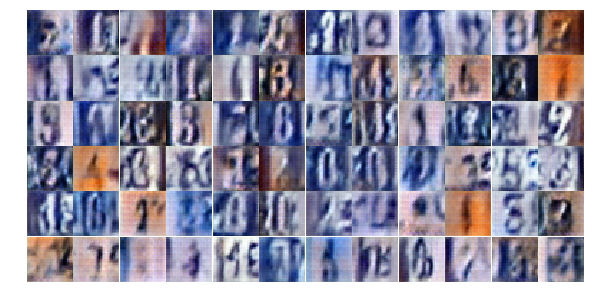

Epoch 19/25... Discriminator Loss: 1.3768... Generator Loss: 0.7082
Epoch 19/25... Discriminator Loss: 1.3759... Generator Loss: 0.6876
Epoch 19/25... Discriminator Loss: 1.3819... Generator Loss: 0.6978
Epoch 19/25... Discriminator Loss: 1.3832... Generator Loss: 0.6932
Epoch 19/25... Discriminator Loss: 1.3686... Generator Loss: 0.6875
Epoch 19/25... Discriminator Loss: 1.3844... Generator Loss: 0.6501
Epoch 19/25... Discriminator Loss: 1.3750... Generator Loss: 0.7112
Epoch 19/25... Discriminator Loss: 1.3762... Generator Loss: 0.7224
Epoch 19/25... Discriminator Loss: 1.3835... Generator Loss: 0.6970
Epoch 19/25... Discriminator Loss: 1.3754... Generator Loss: 0.6819


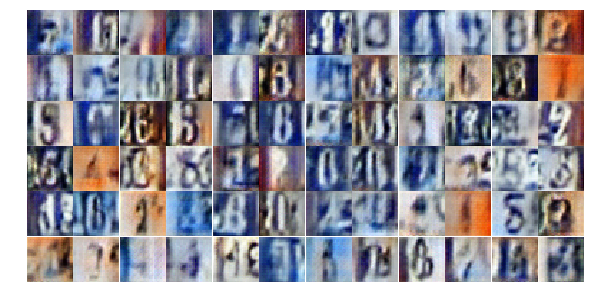

Epoch 19/25... Discriminator Loss: 1.3786... Generator Loss: 0.7133
Epoch 19/25... Discriminator Loss: 1.3935... Generator Loss: 0.7038
Epoch 19/25... Discriminator Loss: 1.3771... Generator Loss: 0.7208
Epoch 19/25... Discriminator Loss: 1.3853... Generator Loss: 0.7016
Epoch 19/25... Discriminator Loss: 1.3845... Generator Loss: 0.7018
Epoch 19/25... Discriminator Loss: 1.3718... Generator Loss: 0.6801
Epoch 19/25... Discriminator Loss: 1.3762... Generator Loss: 0.7000
Epoch 19/25... Discriminator Loss: 1.3843... Generator Loss: 0.7086
Epoch 19/25... Discriminator Loss: 1.3678... Generator Loss: 0.6862
Epoch 19/25... Discriminator Loss: 1.3748... Generator Loss: 0.7115


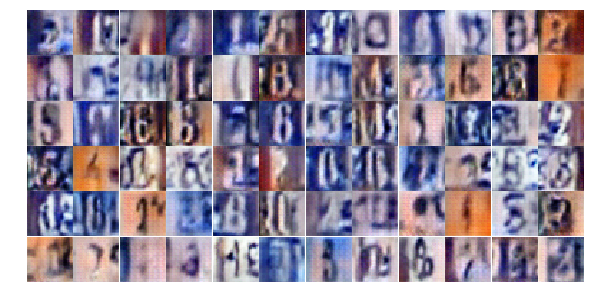

Epoch 19/25... Discriminator Loss: 1.3684... Generator Loss: 0.7128
Epoch 19/25... Discriminator Loss: 1.3938... Generator Loss: 0.6994
Epoch 19/25... Discriminator Loss: 1.3663... Generator Loss: 0.7332
Epoch 19/25... Discriminator Loss: 1.3961... Generator Loss: 0.6810
Epoch 19/25... Discriminator Loss: 1.3719... Generator Loss: 0.7212
Epoch 19/25... Discriminator Loss: 1.3550... Generator Loss: 0.6884
Epoch 19/25... Discriminator Loss: 1.3593... Generator Loss: 0.7082
Epoch 19/25... Discriminator Loss: 1.3825... Generator Loss: 0.7184
Epoch 19/25... Discriminator Loss: 1.3803... Generator Loss: 0.6740
Epoch 19/25... Discriminator Loss: 1.3751... Generator Loss: 0.6792


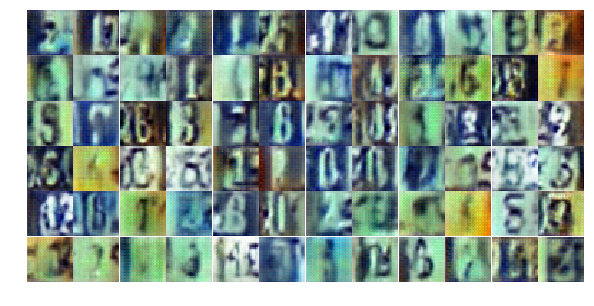

Epoch 19/25... Discriminator Loss: 1.3709... Generator Loss: 0.7348
Epoch 19/25... Discriminator Loss: 1.3904... Generator Loss: 0.6633
Epoch 19/25... Discriminator Loss: 1.4460... Generator Loss: 0.6512
Epoch 19/25... Discriminator Loss: 1.3773... Generator Loss: 0.7110
Epoch 19/25... Discriminator Loss: 1.3854... Generator Loss: 0.6643
Epoch 19/25... Discriminator Loss: 1.3793... Generator Loss: 0.7095
Epoch 19/25... Discriminator Loss: 1.4041... Generator Loss: 0.6683
Epoch 19/25... Discriminator Loss: 1.3983... Generator Loss: 0.7170
Epoch 19/25... Discriminator Loss: 1.3698... Generator Loss: 0.7049
Epoch 19/25... Discriminator Loss: 1.3663... Generator Loss: 0.6746


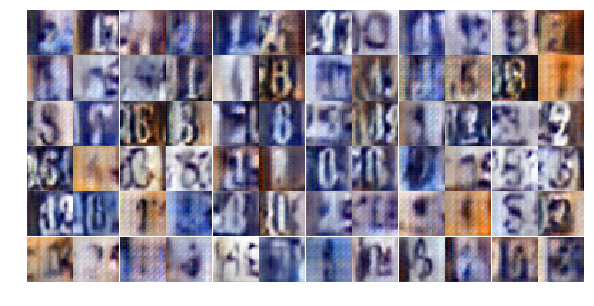

Epoch 19/25... Discriminator Loss: 1.3709... Generator Loss: 0.6948
Epoch 19/25... Discriminator Loss: 1.3456... Generator Loss: 0.7160
Epoch 19/25... Discriminator Loss: 1.3772... Generator Loss: 0.7002
Epoch 19/25... Discriminator Loss: 1.3851... Generator Loss: 0.7381
Epoch 19/25... Discriminator Loss: 1.3714... Generator Loss: 0.6711
Epoch 19/25... Discriminator Loss: 1.3849... Generator Loss: 0.7160
Epoch 19/25... Discriminator Loss: 1.3813... Generator Loss: 0.7174
Epoch 19/25... Discriminator Loss: 1.3687... Generator Loss: 0.6769
Epoch 20/25... Discriminator Loss: 1.3899... Generator Loss: 0.6925
Epoch 20/25... Discriminator Loss: 1.3813... Generator Loss: 0.6863


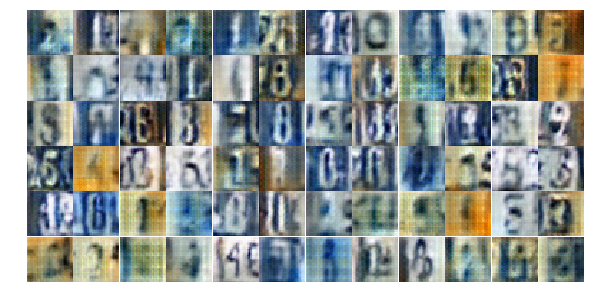

Epoch 20/25... Discriminator Loss: 1.3734... Generator Loss: 0.6720
Epoch 20/25... Discriminator Loss: 1.4072... Generator Loss: 0.6876
Epoch 20/25... Discriminator Loss: 1.3679... Generator Loss: 0.7035
Epoch 20/25... Discriminator Loss: 1.3835... Generator Loss: 0.7048
Epoch 20/25... Discriminator Loss: 1.3686... Generator Loss: 0.6992
Epoch 20/25... Discriminator Loss: 1.3790... Generator Loss: 0.6813
Epoch 20/25... Discriminator Loss: 1.3714... Generator Loss: 0.7012
Epoch 20/25... Discriminator Loss: 1.3860... Generator Loss: 0.6970
Epoch 20/25... Discriminator Loss: 1.3771... Generator Loss: 0.7040
Epoch 20/25... Discriminator Loss: 1.3882... Generator Loss: 0.6849


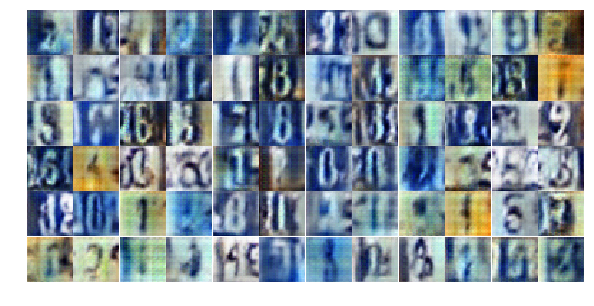

Epoch 20/25... Discriminator Loss: 1.3748... Generator Loss: 0.7047
Epoch 20/25... Discriminator Loss: 1.3971... Generator Loss: 0.6679
Epoch 20/25... Discriminator Loss: 1.3769... Generator Loss: 0.6900
Epoch 20/25... Discriminator Loss: 1.3754... Generator Loss: 0.7103
Epoch 20/25... Discriminator Loss: 1.3859... Generator Loss: 0.6922
Epoch 20/25... Discriminator Loss: 1.3862... Generator Loss: 0.6975
Epoch 20/25... Discriminator Loss: 1.3751... Generator Loss: 0.6979
Epoch 20/25... Discriminator Loss: 1.3815... Generator Loss: 0.6919
Epoch 20/25... Discriminator Loss: 1.3811... Generator Loss: 0.6899
Epoch 20/25... Discriminator Loss: 1.3844... Generator Loss: 0.6803


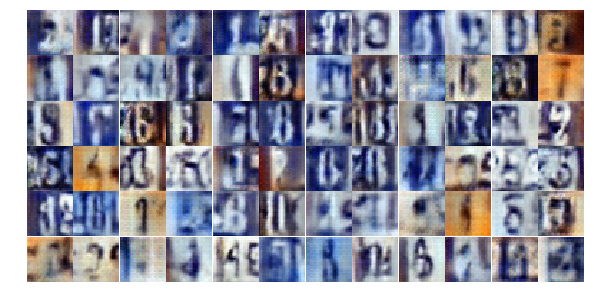

Epoch 20/25... Discriminator Loss: 1.3707... Generator Loss: 0.6689
Epoch 20/25... Discriminator Loss: 1.3743... Generator Loss: 0.6694
Epoch 20/25... Discriminator Loss: 1.3830... Generator Loss: 0.7105
Epoch 20/25... Discriminator Loss: 1.4164... Generator Loss: 0.6816
Epoch 20/25... Discriminator Loss: 1.3975... Generator Loss: 0.6369
Epoch 20/25... Discriminator Loss: 1.3717... Generator Loss: 0.6863
Epoch 20/25... Discriminator Loss: 1.3482... Generator Loss: 0.7162
Epoch 20/25... Discriminator Loss: 1.3577... Generator Loss: 0.7040
Epoch 20/25... Discriminator Loss: 1.3889... Generator Loss: 0.7101
Epoch 20/25... Discriminator Loss: 1.3813... Generator Loss: 0.6849


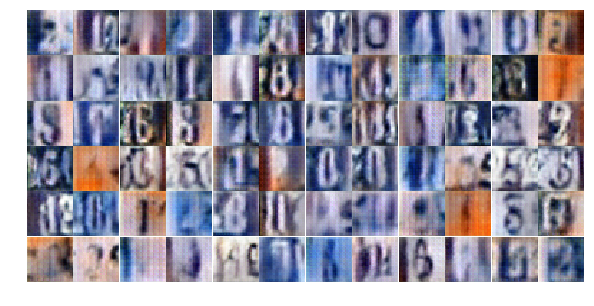

Epoch 20/25... Discriminator Loss: 1.3732... Generator Loss: 0.7187
Epoch 20/25... Discriminator Loss: 1.3739... Generator Loss: 0.6979
Epoch 20/25... Discriminator Loss: 1.3876... Generator Loss: 0.6901
Epoch 20/25... Discriminator Loss: 1.3752... Generator Loss: 0.7171
Epoch 20/25... Discriminator Loss: 1.3717... Generator Loss: 0.6890
Epoch 20/25... Discriminator Loss: 1.3993... Generator Loss: 0.6743
Epoch 20/25... Discriminator Loss: 1.3980... Generator Loss: 0.6803
Epoch 20/25... Discriminator Loss: 1.3908... Generator Loss: 0.6950
Epoch 20/25... Discriminator Loss: 1.3796... Generator Loss: 0.7000
Epoch 20/25... Discriminator Loss: 1.3707... Generator Loss: 0.6896


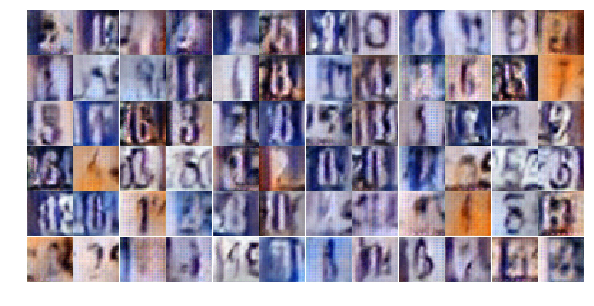

Epoch 20/25... Discriminator Loss: 1.3780... Generator Loss: 0.6999
Epoch 20/25... Discriminator Loss: 1.3870... Generator Loss: 0.7093
Epoch 20/25... Discriminator Loss: 1.3799... Generator Loss: 0.7055
Epoch 20/25... Discriminator Loss: 1.3872... Generator Loss: 0.6889
Epoch 20/25... Discriminator Loss: 1.3963... Generator Loss: 0.6947
Epoch 20/25... Discriminator Loss: 1.3829... Generator Loss: 0.6788
Epoch 20/25... Discriminator Loss: 1.3871... Generator Loss: 0.7052
Epoch 20/25... Discriminator Loss: 1.3810... Generator Loss: 0.6958
Epoch 20/25... Discriminator Loss: 1.3972... Generator Loss: 0.6809
Epoch 20/25... Discriminator Loss: 1.3737... Generator Loss: 0.6969


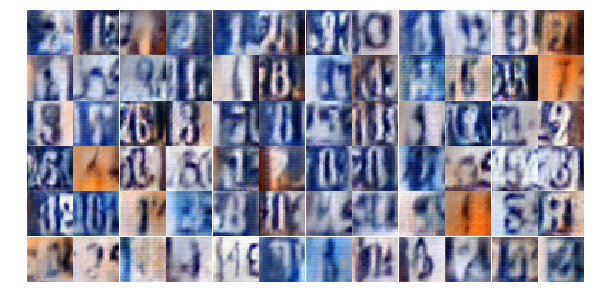

Epoch 20/25... Discriminator Loss: 1.3819... Generator Loss: 0.6987
Epoch 20/25... Discriminator Loss: 1.3794... Generator Loss: 0.7038
Epoch 20/25... Discriminator Loss: 1.3904... Generator Loss: 0.6723
Epoch 20/25... Discriminator Loss: 1.3882... Generator Loss: 0.6916
Epoch 20/25... Discriminator Loss: 1.3768... Generator Loss: 0.6898
Epoch 20/25... Discriminator Loss: 1.3453... Generator Loss: 0.6887
Epoch 21/25... Discriminator Loss: 1.3864... Generator Loss: 0.6719
Epoch 21/25... Discriminator Loss: 1.3824... Generator Loss: 0.6946
Epoch 21/25... Discriminator Loss: 1.3885... Generator Loss: 0.6850
Epoch 21/25... Discriminator Loss: 1.3621... Generator Loss: 0.7210


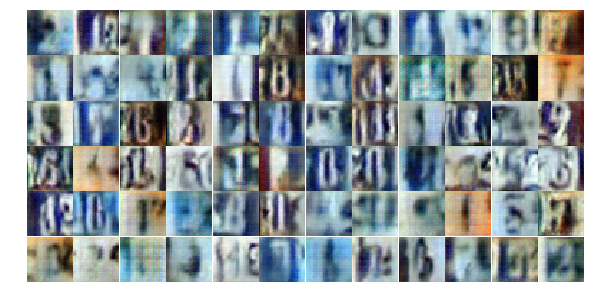

Epoch 21/25... Discriminator Loss: 1.3739... Generator Loss: 0.6785
Epoch 21/25... Discriminator Loss: 1.3944... Generator Loss: 0.6910
Epoch 21/25... Discriminator Loss: 1.3655... Generator Loss: 0.6971
Epoch 21/25... Discriminator Loss: 1.3854... Generator Loss: 0.6835
Epoch 21/25... Discriminator Loss: 1.3947... Generator Loss: 0.6765
Epoch 21/25... Discriminator Loss: 1.3713... Generator Loss: 0.6849
Epoch 21/25... Discriminator Loss: 1.3838... Generator Loss: 0.7073
Epoch 21/25... Discriminator Loss: 1.3752... Generator Loss: 0.7084
Epoch 21/25... Discriminator Loss: 1.3782... Generator Loss: 0.6976
Epoch 21/25... Discriminator Loss: 1.3817... Generator Loss: 0.6851


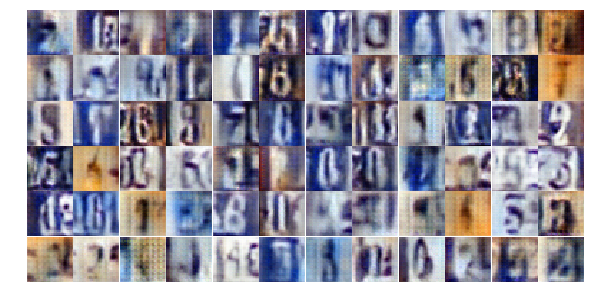

Epoch 21/25... Discriminator Loss: 1.3670... Generator Loss: 0.6894
Epoch 21/25... Discriminator Loss: 1.3790... Generator Loss: 0.6978
Epoch 21/25... Discriminator Loss: 1.3781... Generator Loss: 0.6926
Epoch 21/25... Discriminator Loss: 1.4008... Generator Loss: 0.6624
Epoch 21/25... Discriminator Loss: 1.3692... Generator Loss: 0.6965
Epoch 21/25... Discriminator Loss: 1.3793... Generator Loss: 0.6984
Epoch 21/25... Discriminator Loss: 1.3749... Generator Loss: 0.6904
Epoch 21/25... Discriminator Loss: 1.3889... Generator Loss: 0.6734
Epoch 21/25... Discriminator Loss: 1.3641... Generator Loss: 0.7120
Epoch 21/25... Discriminator Loss: 1.3898... Generator Loss: 0.6964


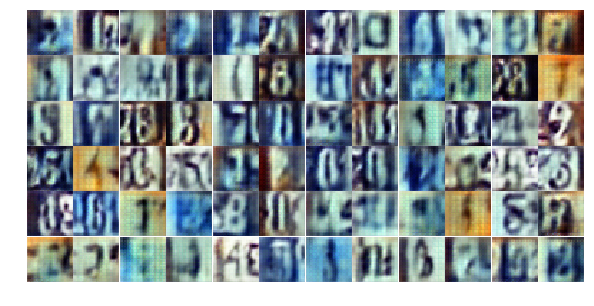

Epoch 21/25... Discriminator Loss: 1.4136... Generator Loss: 0.6831
Epoch 21/25... Discriminator Loss: 1.3944... Generator Loss: 0.6965
Epoch 21/25... Discriminator Loss: 1.4068... Generator Loss: 0.6837
Epoch 21/25... Discriminator Loss: 1.4529... Generator Loss: 0.5992
Epoch 21/25... Discriminator Loss: 1.4147... Generator Loss: 0.6790
Epoch 21/25... Discriminator Loss: 1.3761... Generator Loss: 0.6712
Epoch 21/25... Discriminator Loss: 1.3614... Generator Loss: 0.6969
Epoch 21/25... Discriminator Loss: 1.3817... Generator Loss: 0.6588
Epoch 21/25... Discriminator Loss: 1.3645... Generator Loss: 0.7033
Epoch 21/25... Discriminator Loss: 1.3934... Generator Loss: 0.6920


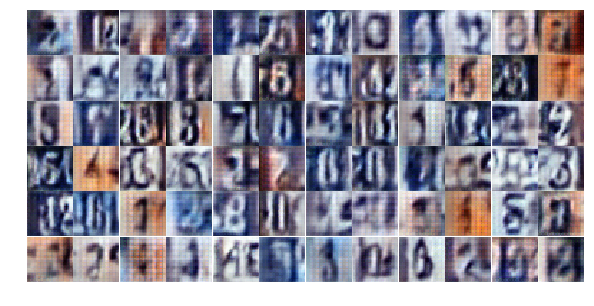

Epoch 21/25... Discriminator Loss: 1.4079... Generator Loss: 0.6721
Epoch 21/25... Discriminator Loss: 1.3756... Generator Loss: 0.7015
Epoch 21/25... Discriminator Loss: 1.4049... Generator Loss: 0.6839
Epoch 21/25... Discriminator Loss: 1.3569... Generator Loss: 0.7077
Epoch 21/25... Discriminator Loss: 1.3948... Generator Loss: 0.6715
Epoch 21/25... Discriminator Loss: 1.3922... Generator Loss: 0.6923
Epoch 21/25... Discriminator Loss: 1.3744... Generator Loss: 0.7052
Epoch 21/25... Discriminator Loss: 1.3984... Generator Loss: 0.6891
Epoch 21/25... Discriminator Loss: 1.3862... Generator Loss: 0.6670
Epoch 21/25... Discriminator Loss: 1.3674... Generator Loss: 0.6986


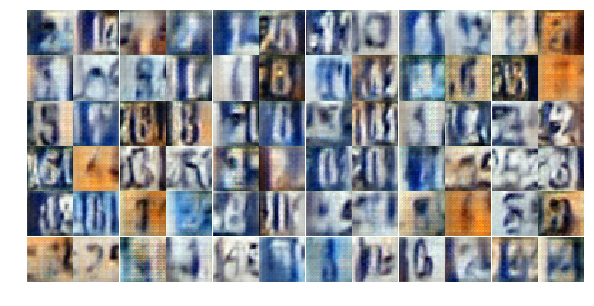

Epoch 21/25... Discriminator Loss: 1.3976... Generator Loss: 0.6969
Epoch 21/25... Discriminator Loss: 1.3808... Generator Loss: 0.7031
Epoch 21/25... Discriminator Loss: 1.3787... Generator Loss: 0.6975
Epoch 21/25... Discriminator Loss: 1.3839... Generator Loss: 0.6987
Epoch 21/25... Discriminator Loss: 1.3944... Generator Loss: 0.6949
Epoch 21/25... Discriminator Loss: 1.3818... Generator Loss: 0.6995
Epoch 21/25... Discriminator Loss: 1.3878... Generator Loss: 0.6950
Epoch 21/25... Discriminator Loss: 1.3921... Generator Loss: 0.6983
Epoch 21/25... Discriminator Loss: 1.3763... Generator Loss: 0.7075
Epoch 21/25... Discriminator Loss: 1.3850... Generator Loss: 0.7030


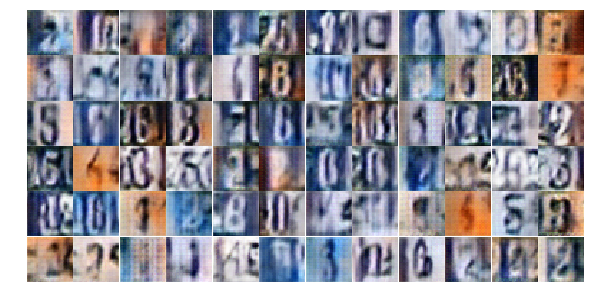

Epoch 21/25... Discriminator Loss: 1.3864... Generator Loss: 0.6952
Epoch 21/25... Discriminator Loss: 1.3796... Generator Loss: 0.6911
Epoch 21/25... Discriminator Loss: 1.3758... Generator Loss: 0.6839
Epoch 22/25... Discriminator Loss: 1.3765... Generator Loss: 0.7023
Epoch 22/25... Discriminator Loss: 1.3718... Generator Loss: 0.6855
Epoch 22/25... Discriminator Loss: 1.3862... Generator Loss: 0.6904
Epoch 22/25... Discriminator Loss: 1.3829... Generator Loss: 0.6975
Epoch 22/25... Discriminator Loss: 1.3904... Generator Loss: 0.7005
Epoch 22/25... Discriminator Loss: 1.3823... Generator Loss: 0.6787
Epoch 22/25... Discriminator Loss: 1.3883... Generator Loss: 0.6930


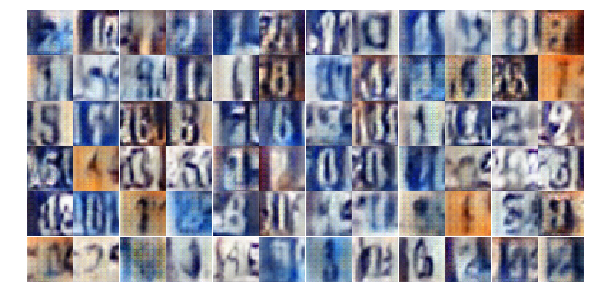

Epoch 22/25... Discriminator Loss: 1.3814... Generator Loss: 0.6911
Epoch 22/25... Discriminator Loss: 1.3864... Generator Loss: 0.7017
Epoch 22/25... Discriminator Loss: 1.3829... Generator Loss: 0.6951
Epoch 22/25... Discriminator Loss: 1.3496... Generator Loss: 0.6911
Epoch 22/25... Discriminator Loss: 1.3833... Generator Loss: 0.6997
Epoch 22/25... Discriminator Loss: 1.3893... Generator Loss: 0.6758
Epoch 22/25... Discriminator Loss: 1.3788... Generator Loss: 0.7092
Epoch 22/25... Discriminator Loss: 1.3864... Generator Loss: 0.6857
Epoch 22/25... Discriminator Loss: 1.3813... Generator Loss: 0.7070
Epoch 22/25... Discriminator Loss: 1.3825... Generator Loss: 0.7063


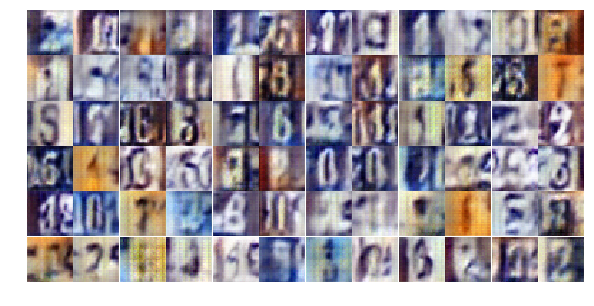

Epoch 22/25... Discriminator Loss: 1.3749... Generator Loss: 0.6926
Epoch 22/25... Discriminator Loss: 1.3671... Generator Loss: 0.6919
Epoch 22/25... Discriminator Loss: 1.3800... Generator Loss: 0.6860
Epoch 22/25... Discriminator Loss: 1.3847... Generator Loss: 0.6961
Epoch 22/25... Discriminator Loss: 1.3809... Generator Loss: 0.6876
Epoch 22/25... Discriminator Loss: 1.3785... Generator Loss: 0.6700
Epoch 22/25... Discriminator Loss: 1.3914... Generator Loss: 0.7087
Epoch 22/25... Discriminator Loss: 1.3727... Generator Loss: 0.6869
Epoch 22/25... Discriminator Loss: 1.3922... Generator Loss: 0.6703
Epoch 22/25... Discriminator Loss: 1.3687... Generator Loss: 0.6983


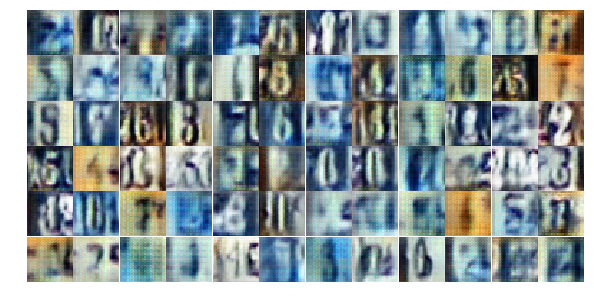

Epoch 22/25... Discriminator Loss: 1.3731... Generator Loss: 0.7022
Epoch 22/25... Discriminator Loss: 1.3850... Generator Loss: 0.6907
Epoch 22/25... Discriminator Loss: 1.3818... Generator Loss: 0.7167
Epoch 22/25... Discriminator Loss: 1.4061... Generator Loss: 0.6787
Epoch 22/25... Discriminator Loss: 1.3665... Generator Loss: 0.6942
Epoch 22/25... Discriminator Loss: 1.3835... Generator Loss: 0.7145
Epoch 22/25... Discriminator Loss: 1.3774... Generator Loss: 0.6384
Epoch 22/25... Discriminator Loss: 1.4017... Generator Loss: 0.7067
Epoch 22/25... Discriminator Loss: 1.4035... Generator Loss: 0.6906
Epoch 22/25... Discriminator Loss: 1.3966... Generator Loss: 0.7210


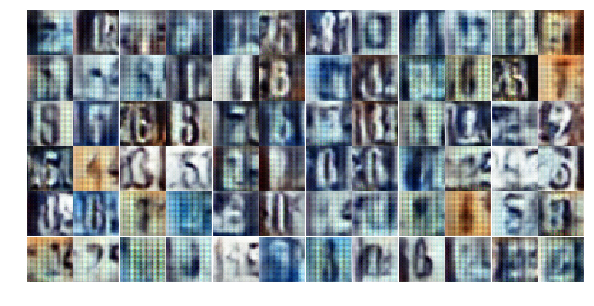

Epoch 22/25... Discriminator Loss: 1.3937... Generator Loss: 0.6929
Epoch 22/25... Discriminator Loss: 1.3937... Generator Loss: 0.7273
Epoch 22/25... Discriminator Loss: 1.3613... Generator Loss: 0.6852
Epoch 22/25... Discriminator Loss: 1.3640... Generator Loss: 0.7018
Epoch 22/25... Discriminator Loss: 1.3869... Generator Loss: 0.7145
Epoch 22/25... Discriminator Loss: 1.4104... Generator Loss: 0.6506
Epoch 22/25... Discriminator Loss: 1.3791... Generator Loss: 0.6968
Epoch 22/25... Discriminator Loss: 1.3921... Generator Loss: 0.6886
Epoch 22/25... Discriminator Loss: 1.3909... Generator Loss: 0.6787
Epoch 22/25... Discriminator Loss: 1.3921... Generator Loss: 0.7018


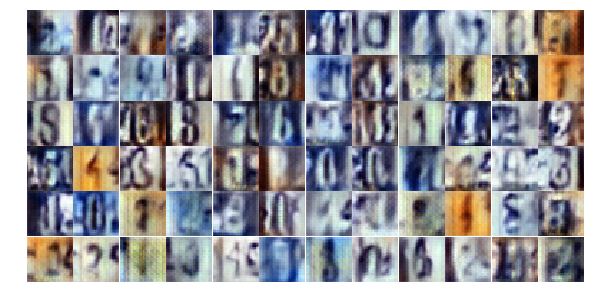

Epoch 22/25... Discriminator Loss: 1.3787... Generator Loss: 0.7251
Epoch 22/25... Discriminator Loss: 1.3953... Generator Loss: 0.7117
Epoch 22/25... Discriminator Loss: 1.3935... Generator Loss: 0.7192
Epoch 22/25... Discriminator Loss: 1.3967... Generator Loss: 0.7009
Epoch 22/25... Discriminator Loss: 1.3925... Generator Loss: 0.6887
Epoch 22/25... Discriminator Loss: 1.3866... Generator Loss: 0.6891
Epoch 22/25... Discriminator Loss: 1.3641... Generator Loss: 0.7056
Epoch 22/25... Discriminator Loss: 1.3824... Generator Loss: 0.6936
Epoch 22/25... Discriminator Loss: 1.3856... Generator Loss: 0.6680
Epoch 22/25... Discriminator Loss: 1.3823... Generator Loss: 0.6913


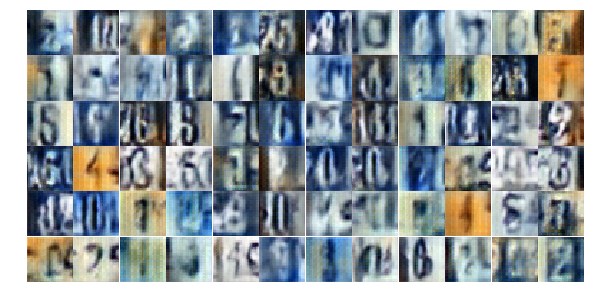

Epoch 23/25... Discriminator Loss: 1.3878... Generator Loss: 0.6806
Epoch 23/25... Discriminator Loss: 1.3684... Generator Loss: 0.6848
Epoch 23/25... Discriminator Loss: 1.3844... Generator Loss: 0.6897
Epoch 23/25... Discriminator Loss: 1.3809... Generator Loss: 0.6714
Epoch 23/25... Discriminator Loss: 1.3828... Generator Loss: 0.6751
Epoch 23/25... Discriminator Loss: 1.3857... Generator Loss: 0.6954
Epoch 23/25... Discriminator Loss: 1.3909... Generator Loss: 0.6885
Epoch 23/25... Discriminator Loss: 1.3864... Generator Loss: 0.6908
Epoch 23/25... Discriminator Loss: 1.3786... Generator Loss: 0.7225
Epoch 23/25... Discriminator Loss: 1.3675... Generator Loss: 0.7256


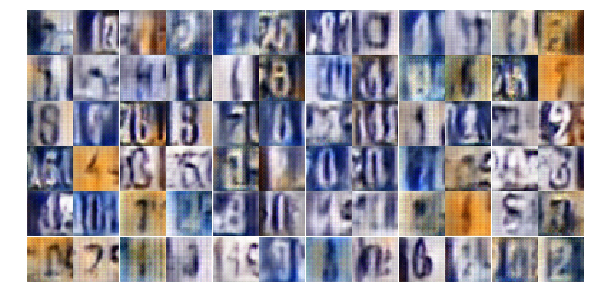

Epoch 23/25... Discriminator Loss: 1.3795... Generator Loss: 0.6947
Epoch 23/25... Discriminator Loss: 1.4019... Generator Loss: 0.6880
Epoch 23/25... Discriminator Loss: 1.3794... Generator Loss: 0.7058
Epoch 23/25... Discriminator Loss: 1.3717... Generator Loss: 0.6980
Epoch 23/25... Discriminator Loss: 1.3861... Generator Loss: 0.6690
Epoch 23/25... Discriminator Loss: 1.3878... Generator Loss: 0.6958
Epoch 23/25... Discriminator Loss: 1.3908... Generator Loss: 0.7063
Epoch 23/25... Discriminator Loss: 1.3783... Generator Loss: 0.7045
Epoch 23/25... Discriminator Loss: 1.3814... Generator Loss: 0.6826
Epoch 23/25... Discriminator Loss: 1.3994... Generator Loss: 0.7063


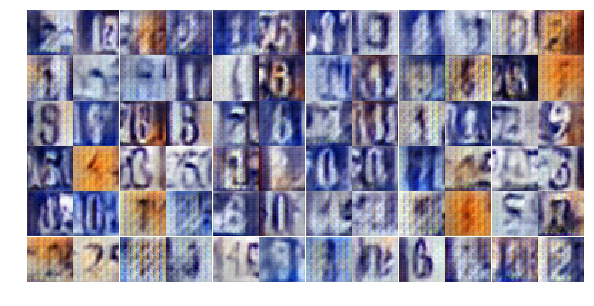

Epoch 23/25... Discriminator Loss: 1.3957... Generator Loss: 0.6913
Epoch 23/25... Discriminator Loss: 1.3745... Generator Loss: 0.7728
Epoch 23/25... Discriminator Loss: 1.3710... Generator Loss: 0.6494
Epoch 23/25... Discriminator Loss: 1.3844... Generator Loss: 0.6926
Epoch 23/25... Discriminator Loss: 1.3846... Generator Loss: 0.7076
Epoch 23/25... Discriminator Loss: 1.3771... Generator Loss: 0.6996
Epoch 23/25... Discriminator Loss: 1.3779... Generator Loss: 0.6921
Epoch 23/25... Discriminator Loss: 1.3684... Generator Loss: 0.6792
Epoch 23/25... Discriminator Loss: 1.3823... Generator Loss: 0.6826
Epoch 23/25... Discriminator Loss: 1.3855... Generator Loss: 0.6816


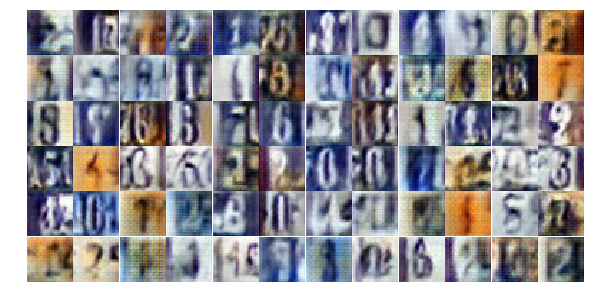

Epoch 23/25... Discriminator Loss: 1.3778... Generator Loss: 0.7021
Epoch 23/25... Discriminator Loss: 1.3801... Generator Loss: 0.6918
Epoch 23/25... Discriminator Loss: 1.3974... Generator Loss: 0.6826
Epoch 23/25... Discriminator Loss: 1.3813... Generator Loss: 0.6962
Epoch 23/25... Discriminator Loss: 1.3865... Generator Loss: 0.6904
Epoch 23/25... Discriminator Loss: 1.3888... Generator Loss: 0.7061
Epoch 23/25... Discriminator Loss: 1.3678... Generator Loss: 0.6846
Epoch 23/25... Discriminator Loss: 1.3958... Generator Loss: 0.7616
Epoch 23/25... Discriminator Loss: 1.3496... Generator Loss: 0.7048
Epoch 23/25... Discriminator Loss: 1.3783... Generator Loss: 0.7213


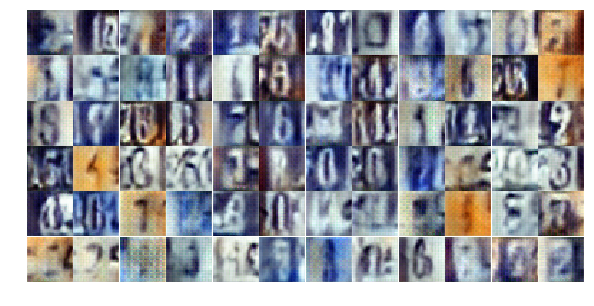

Epoch 23/25... Discriminator Loss: 1.3631... Generator Loss: 0.7104
Epoch 23/25... Discriminator Loss: 1.3711... Generator Loss: 0.6819
Epoch 23/25... Discriminator Loss: 1.3802... Generator Loss: 0.6875
Epoch 23/25... Discriminator Loss: 1.3893... Generator Loss: 0.6834
Epoch 23/25... Discriminator Loss: 1.3890... Generator Loss: 0.6820
Epoch 23/25... Discriminator Loss: 1.3869... Generator Loss: 0.7085
Epoch 23/25... Discriminator Loss: 1.3948... Generator Loss: 0.6985
Epoch 23/25... Discriminator Loss: 1.3877... Generator Loss: 0.6976
Epoch 23/25... Discriminator Loss: 1.3815... Generator Loss: 0.6723
Epoch 23/25... Discriminator Loss: 1.3731... Generator Loss: 0.6951


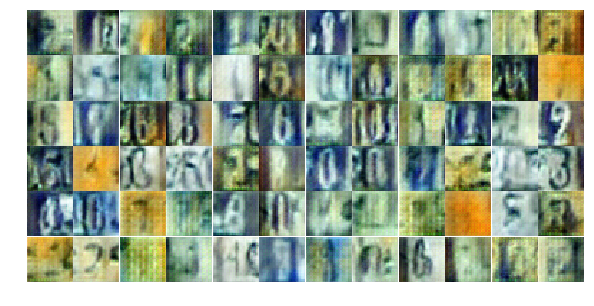

Epoch 23/25... Discriminator Loss: 1.3860... Generator Loss: 0.6915
Epoch 23/25... Discriminator Loss: 1.3821... Generator Loss: 0.7030
Epoch 23/25... Discriminator Loss: 1.3837... Generator Loss: 0.6872
Epoch 23/25... Discriminator Loss: 1.3756... Generator Loss: 0.7072
Epoch 23/25... Discriminator Loss: 1.3818... Generator Loss: 0.6994
Epoch 23/25... Discriminator Loss: 1.3763... Generator Loss: 0.6863
Epoch 23/25... Discriminator Loss: 1.3879... Generator Loss: 0.6925
Epoch 24/25... Discriminator Loss: 1.3951... Generator Loss: 0.6921
Epoch 24/25... Discriminator Loss: 1.3905... Generator Loss: 0.6772
Epoch 24/25... Discriminator Loss: 1.3867... Generator Loss: 0.6860


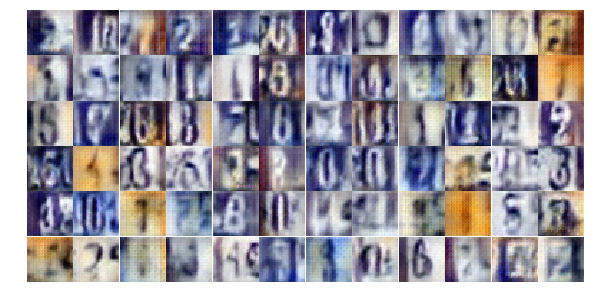

Epoch 24/25... Discriminator Loss: 1.3750... Generator Loss: 0.6970
Epoch 24/25... Discriminator Loss: 1.3882... Generator Loss: 0.6909
Epoch 24/25... Discriminator Loss: 1.3798... Generator Loss: 0.6950
Epoch 24/25... Discriminator Loss: 1.3921... Generator Loss: 0.6931
Epoch 24/25... Discriminator Loss: 1.3792... Generator Loss: 0.7057
Epoch 24/25... Discriminator Loss: 1.3850... Generator Loss: 0.7006
Epoch 24/25... Discriminator Loss: 1.3921... Generator Loss: 0.6906
Epoch 24/25... Discriminator Loss: 1.3962... Generator Loss: 0.7023
Epoch 24/25... Discriminator Loss: 1.3745... Generator Loss: 0.6816
Epoch 24/25... Discriminator Loss: 1.3753... Generator Loss: 0.6855


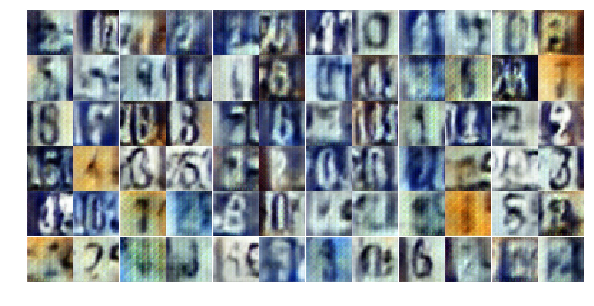

Epoch 24/25... Discriminator Loss: 1.4014... Generator Loss: 0.6967
Epoch 24/25... Discriminator Loss: 1.4376... Generator Loss: 0.5096
Epoch 24/25... Discriminator Loss: 1.3770... Generator Loss: 0.6836
Epoch 24/25... Discriminator Loss: 1.3810... Generator Loss: 0.6269
Epoch 24/25... Discriminator Loss: 1.3778... Generator Loss: 0.6902
Epoch 24/25... Discriminator Loss: 1.3922... Generator Loss: 0.7058
Epoch 24/25... Discriminator Loss: 1.3916... Generator Loss: 0.6715
Epoch 24/25... Discriminator Loss: 1.3673... Generator Loss: 0.7105
Epoch 24/25... Discriminator Loss: 1.3881... Generator Loss: 0.6900
Epoch 24/25... Discriminator Loss: 1.3857... Generator Loss: 0.6976


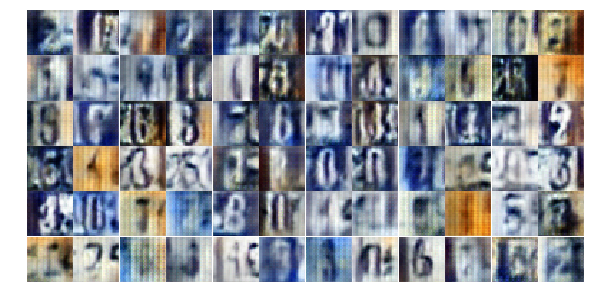

Epoch 24/25... Discriminator Loss: 1.3904... Generator Loss: 0.7021
Epoch 24/25... Discriminator Loss: 1.3769... Generator Loss: 0.6871
Epoch 24/25... Discriminator Loss: 1.3863... Generator Loss: 0.6961
Epoch 24/25... Discriminator Loss: 1.3791... Generator Loss: 0.7053
Epoch 24/25... Discriminator Loss: 1.3880... Generator Loss: 0.6932
Epoch 24/25... Discriminator Loss: 1.3758... Generator Loss: 0.6928
Epoch 24/25... Discriminator Loss: 1.3971... Generator Loss: 0.6907
Epoch 24/25... Discriminator Loss: 1.3888... Generator Loss: 0.6909
Epoch 24/25... Discriminator Loss: 1.3735... Generator Loss: 0.7112
Epoch 24/25... Discriminator Loss: 1.3816... Generator Loss: 0.6973


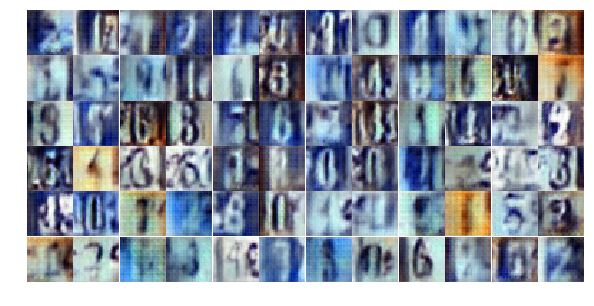

Epoch 24/25... Discriminator Loss: 1.3848... Generator Loss: 0.6925
Epoch 24/25... Discriminator Loss: 1.3970... Generator Loss: 0.6784
Epoch 24/25... Discriminator Loss: 1.3866... Generator Loss: 0.7023
Epoch 24/25... Discriminator Loss: 1.3886... Generator Loss: 0.6942
Epoch 24/25... Discriminator Loss: 1.3959... Generator Loss: 0.6810
Epoch 24/25... Discriminator Loss: 1.3736... Generator Loss: 0.6989
Epoch 24/25... Discriminator Loss: 1.4112... Generator Loss: 0.6927
Epoch 24/25... Discriminator Loss: 1.4000... Generator Loss: 0.6778
Epoch 24/25... Discriminator Loss: 1.4023... Generator Loss: 0.6594
Epoch 24/25... Discriminator Loss: 1.3931... Generator Loss: 0.6957


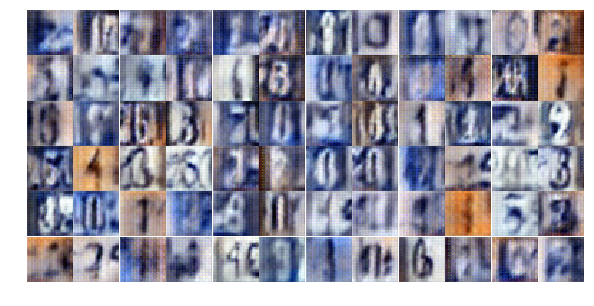

Epoch 24/25... Discriminator Loss: 1.3738... Generator Loss: 0.7034
Epoch 24/25... Discriminator Loss: 1.3754... Generator Loss: 0.7047
Epoch 24/25... Discriminator Loss: 1.3982... Generator Loss: 0.6642
Epoch 24/25... Discriminator Loss: 1.4011... Generator Loss: 0.6852
Epoch 24/25... Discriminator Loss: 1.4031... Generator Loss: 0.7025
Epoch 24/25... Discriminator Loss: 1.3929... Generator Loss: 0.6797
Epoch 24/25... Discriminator Loss: 1.3858... Generator Loss: 0.6937
Epoch 24/25... Discriminator Loss: 1.3827... Generator Loss: 0.6981
Epoch 24/25... Discriminator Loss: 1.3944... Generator Loss: 0.6922
Epoch 24/25... Discriminator Loss: 1.3805... Generator Loss: 0.7060


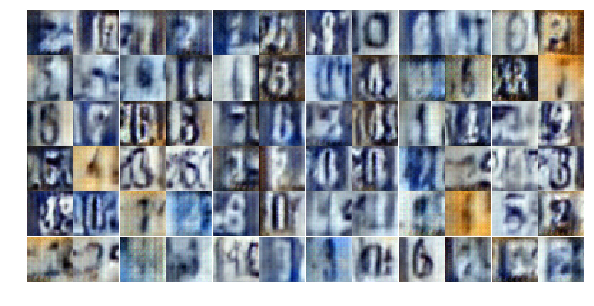

Epoch 24/25... Discriminator Loss: 1.3929... Generator Loss: 0.6905
Epoch 24/25... Discriminator Loss: 1.3805... Generator Loss: 0.6938
Epoch 24/25... Discriminator Loss: 1.3750... Generator Loss: 0.6941
Epoch 24/25... Discriminator Loss: 1.3883... Generator Loss: 0.6690
Epoch 24/25... Discriminator Loss: 1.3900... Generator Loss: 0.6887
Epoch 25/25... Discriminator Loss: 1.3816... Generator Loss: 0.6967
Epoch 25/25... Discriminator Loss: 1.3889... Generator Loss: 0.6925
Epoch 25/25... Discriminator Loss: 1.3863... Generator Loss: 0.6961
Epoch 25/25... Discriminator Loss: 1.3822... Generator Loss: 0.6913
Epoch 25/25... Discriminator Loss: 1.3831... Generator Loss: 0.6925


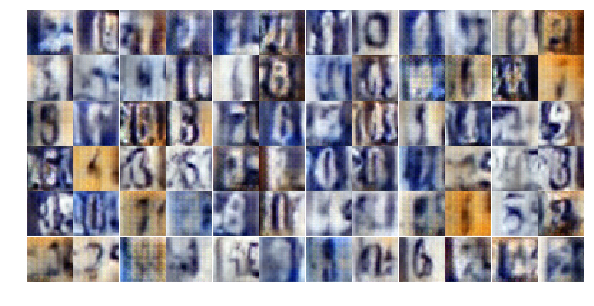

Epoch 25/25... Discriminator Loss: 1.3785... Generator Loss: 0.6953
Epoch 25/25... Discriminator Loss: 1.3822... Generator Loss: 0.7015
Epoch 25/25... Discriminator Loss: 1.3839... Generator Loss: 0.7218
Epoch 25/25... Discriminator Loss: 1.3863... Generator Loss: 0.6873
Epoch 25/25... Discriminator Loss: 1.3904... Generator Loss: 0.6929
Epoch 25/25... Discriminator Loss: 1.3865... Generator Loss: 0.6976
Epoch 25/25... Discriminator Loss: 1.3861... Generator Loss: 0.6746
Epoch 25/25... Discriminator Loss: 1.3792... Generator Loss: 0.6881
Epoch 25/25... Discriminator Loss: 1.3917... Generator Loss: 0.7320
Epoch 25/25... Discriminator Loss: 1.3817... Generator Loss: 0.6979


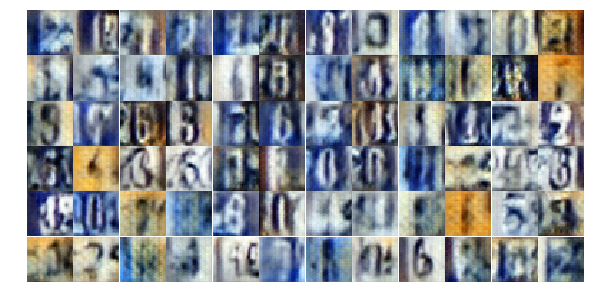

Epoch 25/25... Discriminator Loss: 1.3917... Generator Loss: 0.6800
Epoch 25/25... Discriminator Loss: 1.3867... Generator Loss: 0.6919
Epoch 25/25... Discriminator Loss: 1.3879... Generator Loss: 0.6897
Epoch 25/25... Discriminator Loss: 1.3847... Generator Loss: 0.7150
Epoch 25/25... Discriminator Loss: 1.3877... Generator Loss: 0.6951
Epoch 25/25... Discriminator Loss: 1.3803... Generator Loss: 0.7037
Epoch 25/25... Discriminator Loss: 1.3928... Generator Loss: 0.7009
Epoch 25/25... Discriminator Loss: 1.3812... Generator Loss: 0.6892
Epoch 25/25... Discriminator Loss: 1.3958... Generator Loss: 0.7166
Epoch 25/25... Discriminator Loss: 1.3783... Generator Loss: 0.6983


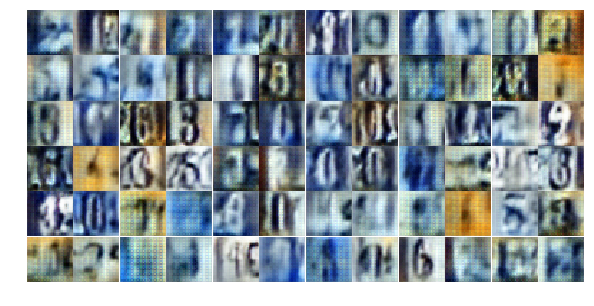

Epoch 25/25... Discriminator Loss: 1.3865... Generator Loss: 0.6943
Epoch 25/25... Discriminator Loss: 1.3788... Generator Loss: 0.6789
Epoch 25/25... Discriminator Loss: 1.3924... Generator Loss: 0.6983
Epoch 25/25... Discriminator Loss: 1.3880... Generator Loss: 0.6802
Epoch 25/25... Discriminator Loss: 1.3756... Generator Loss: 0.6862
Epoch 25/25... Discriminator Loss: 1.3890... Generator Loss: 0.6863
Epoch 25/25... Discriminator Loss: 1.3878... Generator Loss: 0.6917
Epoch 25/25... Discriminator Loss: 1.3837... Generator Loss: 0.6921
Epoch 25/25... Discriminator Loss: 1.3861... Generator Loss: 0.7095


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))